# UMAPs Neurips samples, NK cells

In this notebook different markers to identify NK cell subpopulations are tested. Markers are collected from paper by Yang et al., (2019). RNA and corresponding surface markers are shown when available. Protein expression levels within a cell are normalized using the centered-log ratio (CLR) transformation. UMAPs are generated using latent space representation of measured RNA and surface protein data. 


Reference: Yang, C., Siebert, J. R., Burns, R., Gerbec, Z. J., Bonacci, B., Rymaszewski, A., Rau, M., Riese, M. J., Rao, S., Carlson, K. S., Routes, J. M., Verbsky, J. W., Thakar, M. S., & Malarkannan, S. (2019). Heterogeneity of human bone marrow and blood natural killer cells defined by single-cell transcriptome. Nature communications, 10(1), 3931. https://doi.org/10.1038/s41467-019-11947-7


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
#Neurips
adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [3]:
adata_neurips

AnnData object with n_obs × n_vars = 80998 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [4]:
#To find gene names

result = [i for i in adata_neurips.var_names if i.startswith('ROR')]
print(result)

['ROR1', 'ROR2', 'RORA', 'RORA-AS1', 'RORB', 'RORC']


In [5]:
adata_neurips.obs['cell_type'].unique().tolist()

['NK',
 'CD8+ T CD69+ CD45RA+',
 'NK CD158e1+',
 'HSC',
 'CD14+ Mono',
 'B1 B IGKC+',
 'CD4+ T activated',
 'CD8+ T CD69+ CD45RO+',
 'G/M prog',
 'Naive CD20+ B IGKC-',
 'CD8+ T CD49f+',
 'Naive CD20+ B IGKC+',
 'CD4+ T naive',
 'CD8+ T naive',
 'CD4+ T activated integrinB7+',
 'cDC2',
 'gdT TCRVD2+',
 'CD8+ T TIGIT+ CD45RO+',
 'CD16+ Mono',
 'Erythroblast',
 'MAIT',
 'T reg',
 'gdT CD158b+',
 'Transitional B',
 'Proerythroblast',
 'CD8+ T CD57+ CD45RO+',
 'Plasmablast IGKC+',
 'ILC1',
 'Lymph prog',
 'ILC',
 'MK/E prog',
 'Normoblast',
 'CD8+ T CD57+ CD45RA+',
 'pDC',
 'B1 B IGKC-',
 'Plasma cell IGKC-',
 'Plasmablast IGKC-',
 'Plasma cell IGKC+',
 'CD8+ T TIGIT+ CD45RA+',
 'CD8+ T naive CD127+ CD26- CD101-',
 'CD4+ T CD314+ CD45RA+',
 'cDC1',
 'T prog cycling',
 'dnT']

In [6]:
#Both NK cell types selected


neurips_nk = adata_neurips[(adata_neurips.obs['cell_type'] == "NK") | (adata_neurips.obs['cell_type'] == "NK CD158e1+")]

In [7]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [8]:
neurips_nk_prot=neurips_nk.obsm['protein_expression_clr_neurips']

In [9]:
#To exclude columns that contain only zeros

neurips_nk_prot = pd.DataFrame(neurips_nk_prot)
neurips_nk_prot != 0
(neurips_nk_prot != 0).any(axis=0)
neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]
neurips_nk_prot = neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]

In [10]:
samples=adata_neurips.obs['POOL'].unique().tolist()

In [11]:
#selecting one sample from Neurips

eg=adata_neurips[adata_neurips.obs['POOL'] == "s4d1"].copy()


In [12]:
eg

AnnData object with n_obs × n_vars = 4885 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [13]:
prot=eg.obsm['protein_expression_clr_neurips']

In [14]:
prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,HLA-E,CD82,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,1.532575,0.614600,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0
CTCAAGAGTCACAGAG-1-s4d1,0.652674,1.069339,1.657770,0.890243,1.377072,1.264995,1.863027,1.101769,1.562259,1.072649,...,1.283465,0.614600,1.786480,0.762359,1.112478,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,1.344431,0.353792,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0
CGTGATAGTTATCTGG-1-s4d1,0.000000,1.249182,1.335424,1.256332,2.674106,1.322314,0.289336,1.240123,1.397398,1.525053,...,0.859205,1.527772,0.629556,0.854928,1.000442,0.0,0.0,0.0,0.0,0.0
AGATCCAAGATCGGTG-1-s4d1,2.784459,1.132949,1.674846,1.669058,1.663981,2.101246,2.112640,1.417276,1.884321,1.861734,...,1.429432,1.031029,2.808629,2.007436,2.064066,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGATCGTCTCTATAC-1-s4d1,0.000000,1.132949,1.358918,1.523729,1.195368,1.312986,1.077960,1.173337,1.690467,1.013739,...,1.482333,0.353792,0.576253,1.157734,1.304730,0.0,0.0,0.0,0.0,0.0
AAGACTCAGGGCAAGG-1-s4d1,0.652674,1.302596,1.208881,0.541080,1.090419,1.589583,1.436578,1.240123,1.379313,0.561056,...,1.149104,0.614600,0.818218,1.189870,1.180752,0.0,0.0,0.0,0.0,0.0
CGAGAAGCACCTCGTT-1-s4d1,0.378666,0.764571,1.208881,0.730824,1.494512,1.944753,2.308527,0.941152,1.342130,1.231042,...,1.184424,0.773465,0.939506,1.017749,1.112478,0.0,0.0,0.0,0.0,0.0
TATCCTAGTTCTCCTG-1-s4d1,0.000000,1.302596,1.286711,0.890243,1.377072,1.150531,0.882414,1.469979,1.649530,0.607664,...,1.401893,1.405442,0.860303,1.124532,1.304730,0.0,0.0,0.0,0.0,0.0


In [15]:
prot=prot.rename(columns={'CD2': 'CD2_prot', 'CX3CR1': 'CX3CR1_prot', 'CD52': 'CD52_prot','CD69': 'CD69_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD34': 'CD34_prot','CD5': 'CD5_prot'})


In [16]:
#some proteins and genes have same names, here _prot added after protein names

a = eg.obs
b = prot

adata_eg=pd.concat([a, b], axis=1)
eg.obs=adata_eg


In [17]:
#selecting NK cells, gd T cells and ILCs

sample_nk = eg[(eg.obs['cell_type'] == "NK") | (eg.obs['cell_type'] == "NK CD158e1+") | (eg.obs['cell_type'] == "ILC") | (eg.obs['cell_type'] == "gdT CD158b+")].copy()   


In [18]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_neurips, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(adata_neurips)

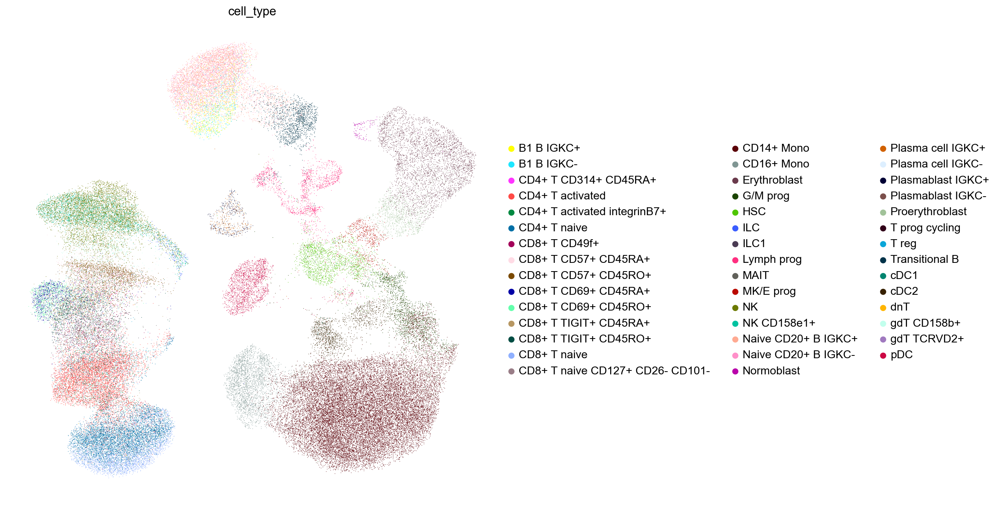

In [19]:
#Whole Neurips dataset, coloured by annotated cell types

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_neurips, color = ['cell_type'], frameon = False)

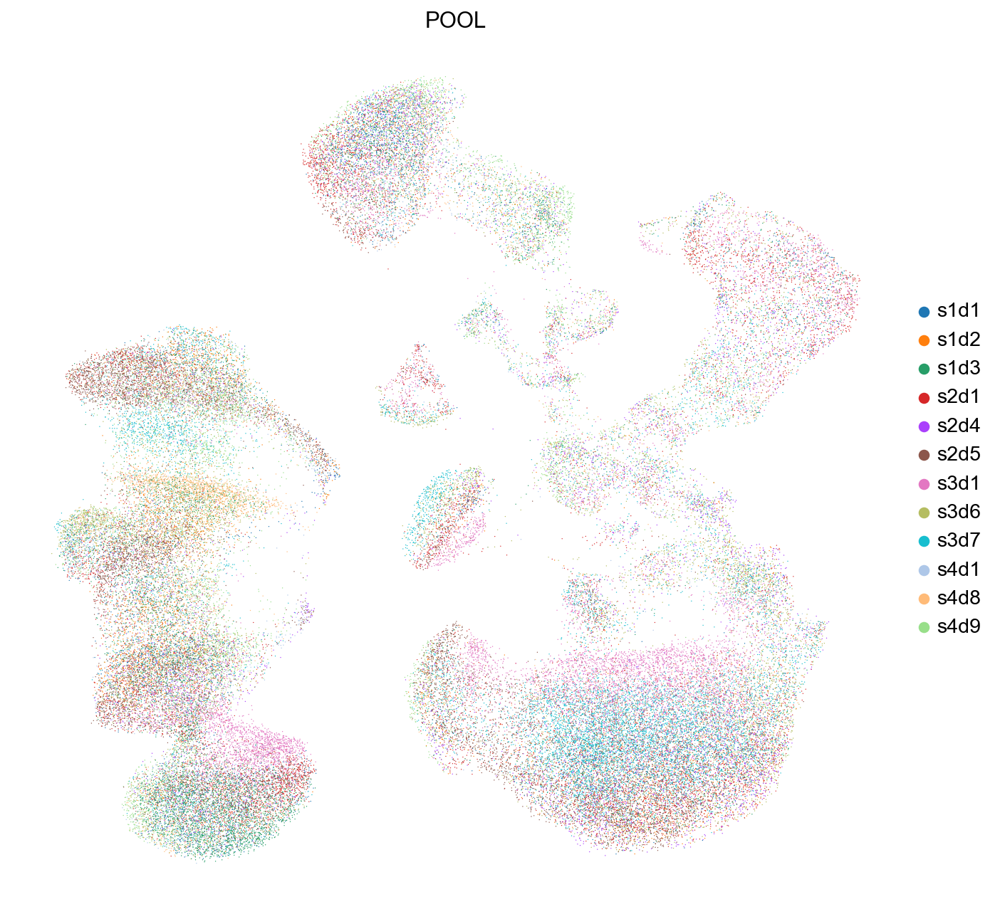

In [20]:
#Whole neurips dataset, coloured by samples

sc.pl.umap(adata_neurips, color = ['POOL'], frameon = False)

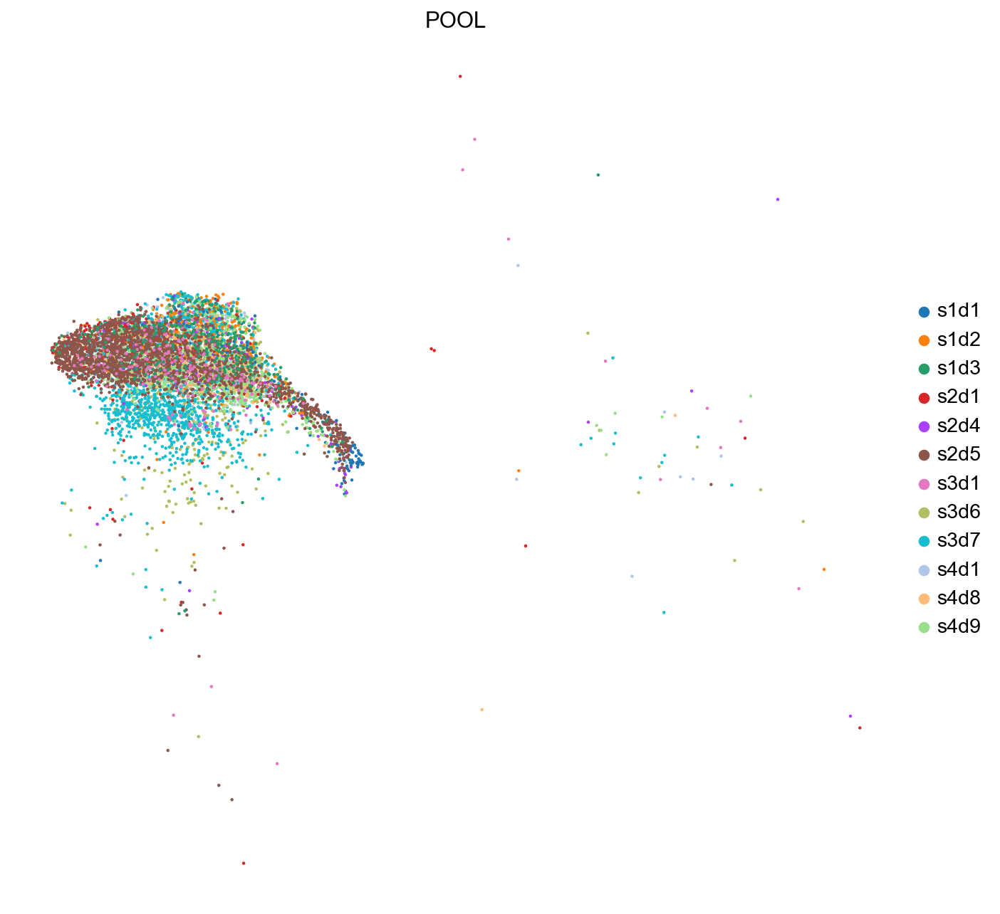

In [21]:
#All samples, but only selected cell types (NK, ILC and gd T cells)

sc.pl.umap(neurips_nk, color = ['POOL'], frameon = False)

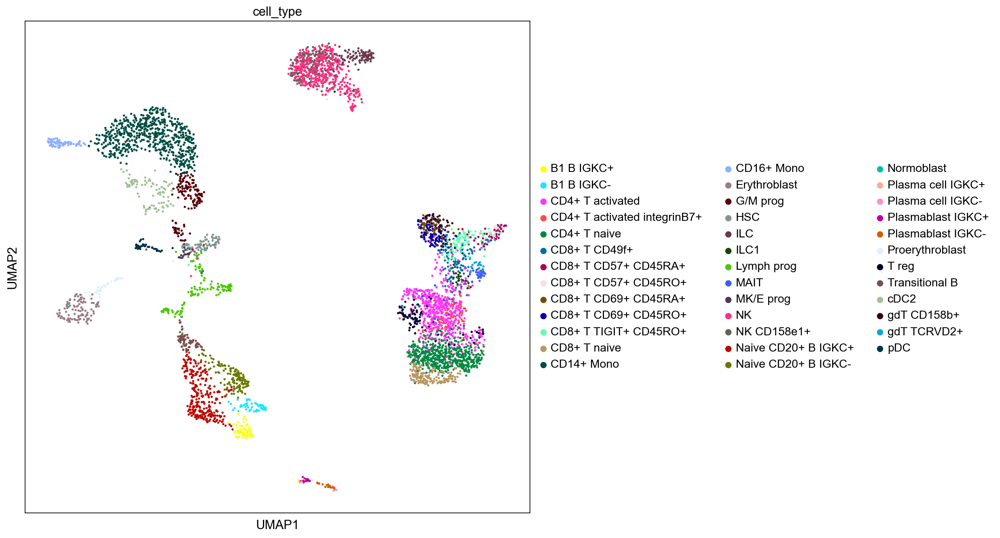

In [22]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

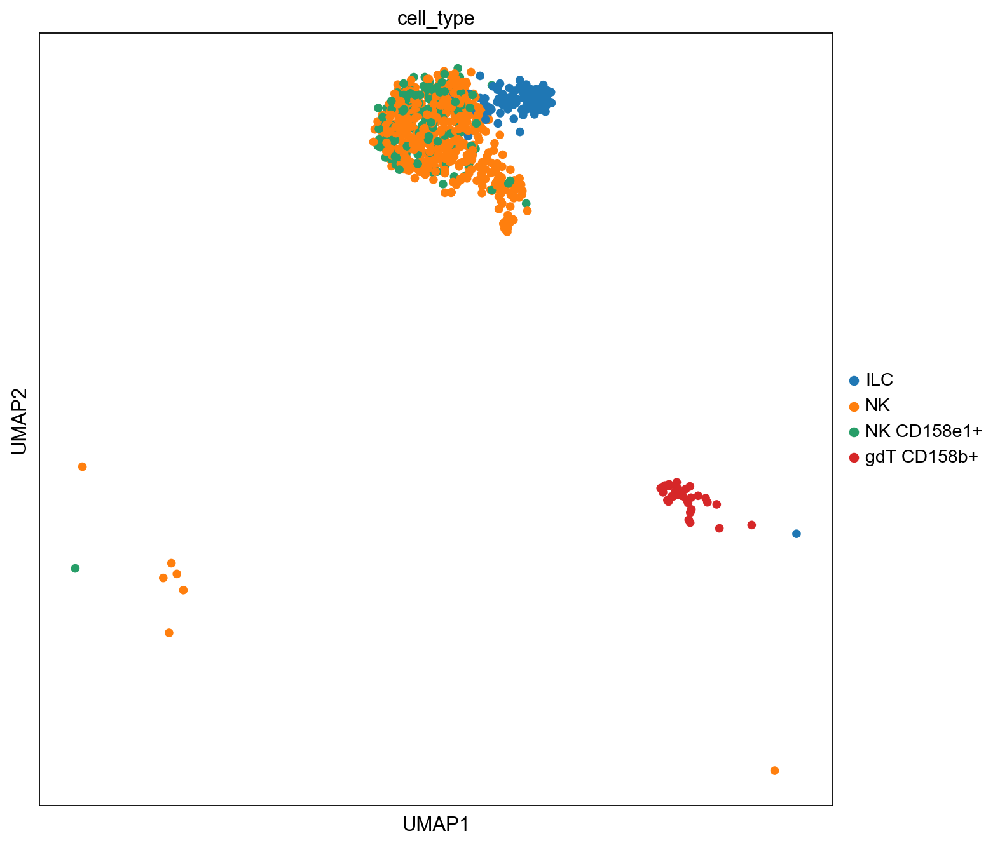

In [23]:
sc.pl.umap(sample_nk, color = ['cell_type'])

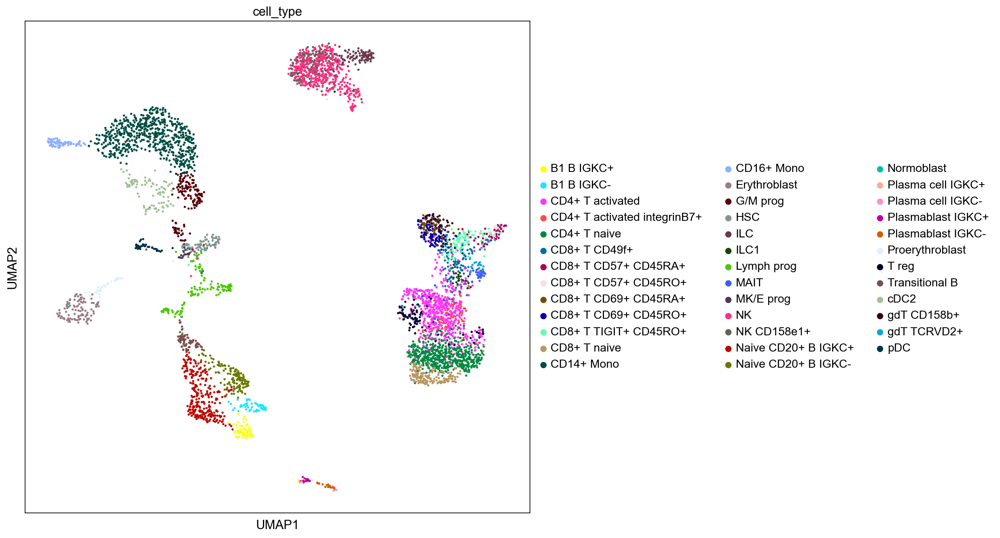

In [24]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

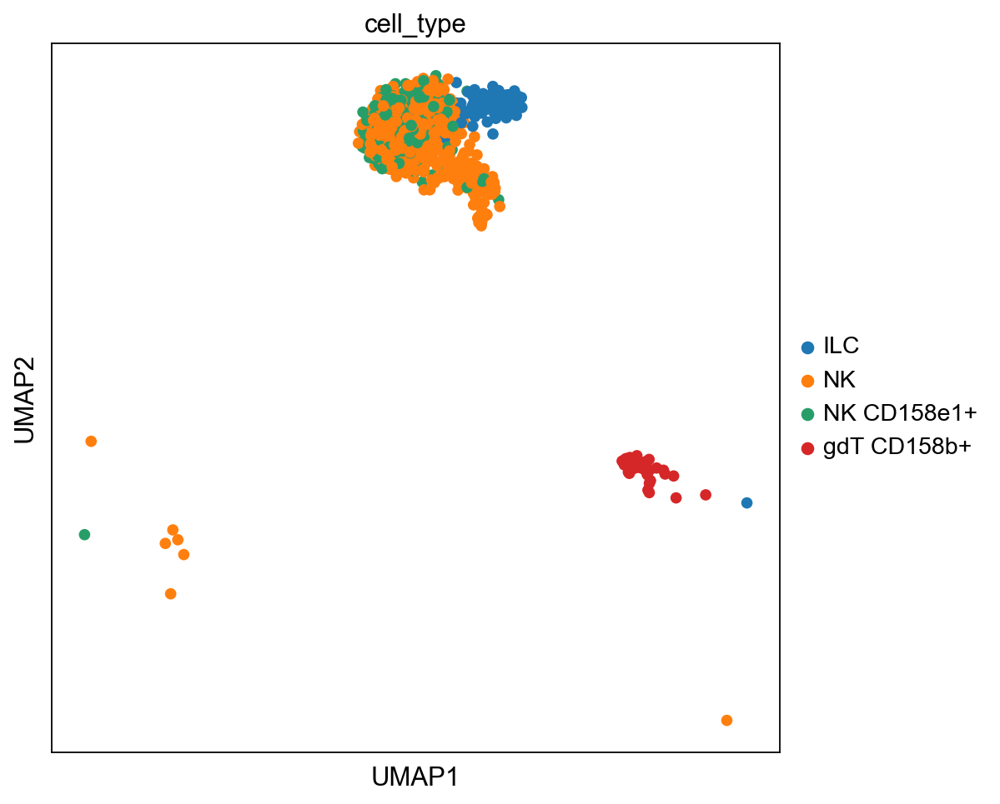

In [25]:
#one sample, only NKs + ILCs

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'])

# 1.  Markers by Yang et al. 

- sscRNA-seq on BM (n=6) and PB (n=2). In total, 5567 and 3046 NK cells from the BM and blood were analyzed. 

- Recently, the definition of the NK cell-restricted progenitor population has been redefined as Lin− CD34+CD38+CD123−CD45RA+CD7+CD10+CD127− cells as a consistent fraction of putative NK precursors in secondary lymphoid organs turn out to be ILCs or ILC progenitors

- NK cell maturation occurs mostly in secondary lymphoidal organs. The analyses of NK cells from secondary lymphoidal organs will give insights into early NK developmental stages. In this study they were not able to detect earlier development states of NK cells. 

- Markers to define NK lineage: CD94 (KLRD1), NKp80 (KLRF1), NKG7 and GNLY. NCAM1 (CD56) as well, but was not well represented in this study.

- Markers used to catch NK cells (also progenitors/ILCs): Lin−, CD7+ (not all cells yet CD56+).

- Within this Lin−, CD7+ population 90% are CD56bright NK cells.

- Remaining CD56dim/- cells: over 50% express KLRC1 (NKp80) and CD16 => mature NK cells, rest (CD7+, CD56dim/−, CD16−, NKp80−) probably ILCs, NK progenitors, immature NK cells or immature cells with multiple lineages potential.  

- maturation of  CD56dimCXCR4+ NK cells = NKG2A, CD62L, CD57


### 7 clusters from BM NK cells: #

1. CD56bright NK

2. Transitional NK (intermediate expression of signature genes of either CD56bright or CD56dimCD57+ NK cells)

3. Adaptive NK: High KLRC2 expression, only detected from BM, mostly composed of cells of one donor. Also cells from few other samples detected, not high KLRC2, but instead high CD52 expression.

4. Mature NK:  High expression of molecules important for cytotoxic function. Enrichment of gene sets, including the apical junction, regulation of actin cytoskeleton, NK cell-mediated cytotoxicity, and structure constituent of the cytoskeleton in the “Mature NK” cluster com- pared to the rest of the cells

5. Terminal NK: Mature NK and terminal NK clusters together form the CD57+ cell population. Similar transcriptional and functional profile as mature NKs, but increased expression of ZEB2,  CX3CR1 and HAVCR2 (TIM-3). Dampened signaling and metabolic profiles => quiescent state? 

6. Active NK : same features as inflamed NK. Several genes that belong to the immediate early genes (IEGs). IEGs are induced rapidly in response to stimuli without nascent protein synthesis. Active transcription, activation of several signaling pathways (KRAS-MAPK, TRAF6-NF-kappa-B. Active NK cluster is potentially within the CD56dim NK population (mature NKs) with a decreased expression of the genes encoding cytolytic proteins compared to the mature NK cluster. Maybe not unique developmental stage. 

7. Inflamed NK (mostly composed of cells of one patient, who donored BM) 


### Markers: #

- Is NK: KLRD1 (CD94), KLRF1, NKG7, GNLY, NCAM1 (CD56), CD7

- CD56brigh: IL7RA (IL7R), SELL (CD62L), NKG2A (KLRC1), GZMK, CD44, XCL1, XCL2. Minimal expression of FCGR3A (CD16), B3GAT1 (CD57) and CD160. 

- Adaptive: KLRC2 (NKG2C), CD52, CD3E/D/G. Low expresison of FcεRγ (FCER1G), SYK (SYK), EAT-2 (SH2D1B), and PLZF (ZBTB16) compared to other clusters

- Mature NK: B3GAT1 (CD57), PRF1, GZMA, GZMB, GZMH, ACTB, ARPC2, CORO1A, CFL1, CST7, PFN1, ANXA1). 

- Terminal NK: 
 - bonemarrow: ZEB2, CX3CR1 and HAVCR2 (TIM-3), WDR74, SNORD3A, TMEM107, SNORD3D, RNU12, SNORD3B-2, SNORD3B-1, C12orf57, HIST1H1E, HIST1H1C, HIST1H1D, HIST2H2BE, RNU11, JUN, PTCH2, RP11-386I14.4,CD38. 
 - Peripheral blood: MYBL1, CX3CR1, RNU12, DDX17, HIST1H1C, TMEM107, SNORD3A, NKTR, WDR74, HIST2H2BE, HIST1H1E, HIST1H1D

- Active NK: NFKBIA, JUN, JUNB, ZFP36, DOS, FOSB, DUSP1, NR4A2, CXCR4

- Inflamed NK: IFIT3, IFIT2, TNF, CD69




## 1.1 NK lineage defining markers

In [26]:
is_nk_yang = ['KLRD1', 'KLRF1', 'NKG7', 'GNLY', 'NCAM1'] #the most DE genes in NK cells
is_nk_yang_prot = ['CD94','CD56', 'CD7_prot'] 


# NKp80 (KLRF1) not in the ab panel of Neurips
# KLRD1 = CD94, NCAM1 = CD56

In [27]:
#Used to check which genes were measured

listOfmarkers= ['CD52']


for x in listOfmarkers:
    if x in adata_neurips.var_names:
        print(x)


CD52


In [28]:
#Used to check which markers were measured

listOfmarkers= ["CD184"]

for x in listOfmarkers:
    if x in prot.columns:
        print(x)


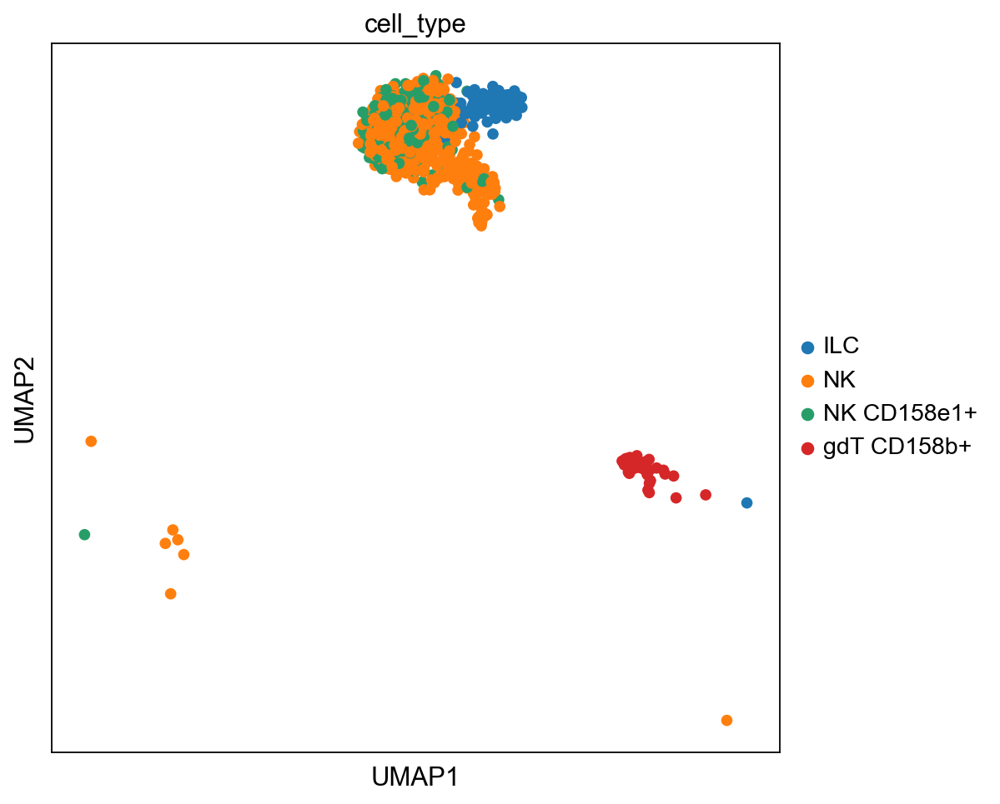

Is NK cell, RNA


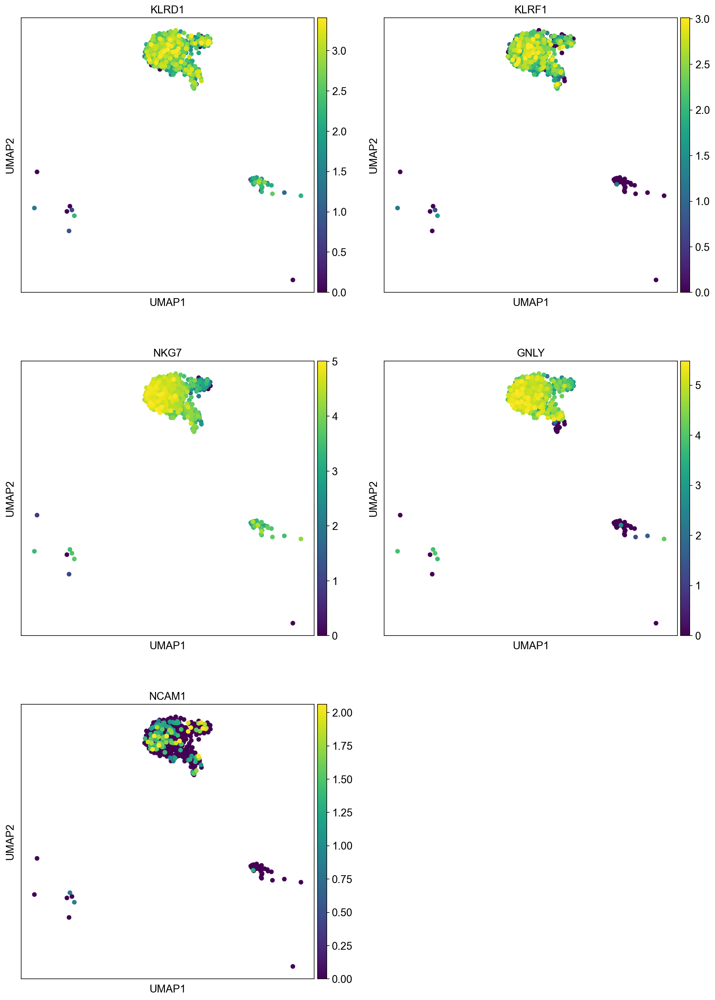

Is NK cell, protein (KLRD1 = CD94, NCAM1 = CD56)


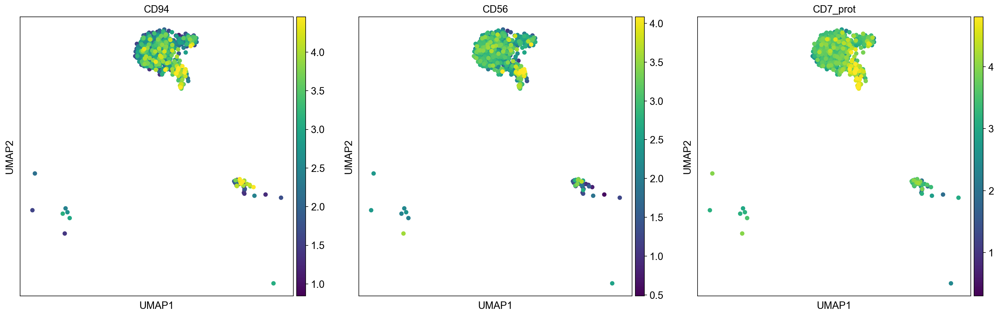

In [29]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, RNA")
sc.pl.umap(sample_nk, color = is_nk_yang, vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, protein (KLRD1 = CD94, NCAM1 = CD56)")

sc.pl.umap(sample_nk, color = is_nk_yang_prot, vmax="p99", color_map = 'viridis')

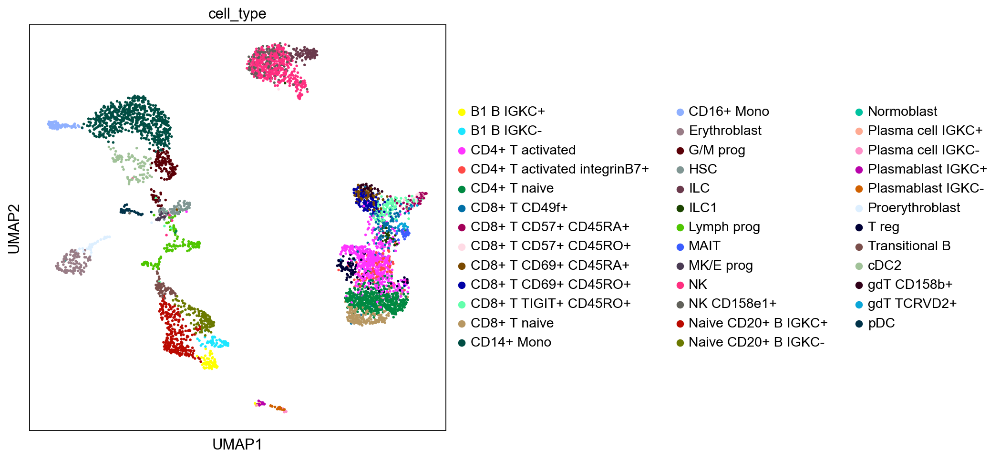

Is NK cell, RNA


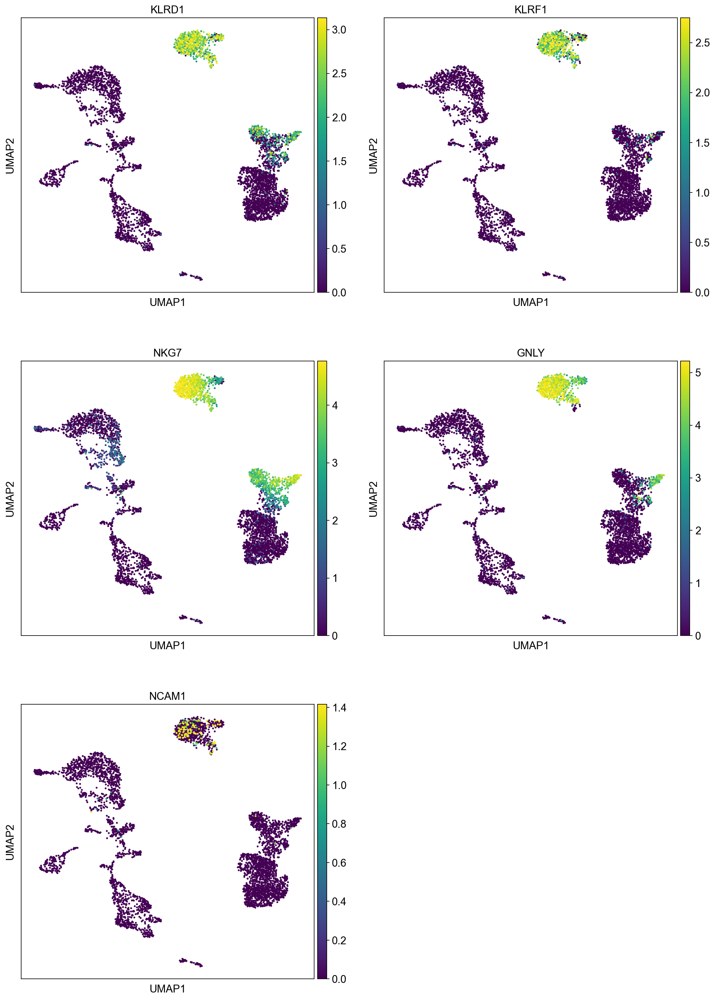

Is NK cell, protein (KLRD1 = CD94, NCAM1 = CD56)


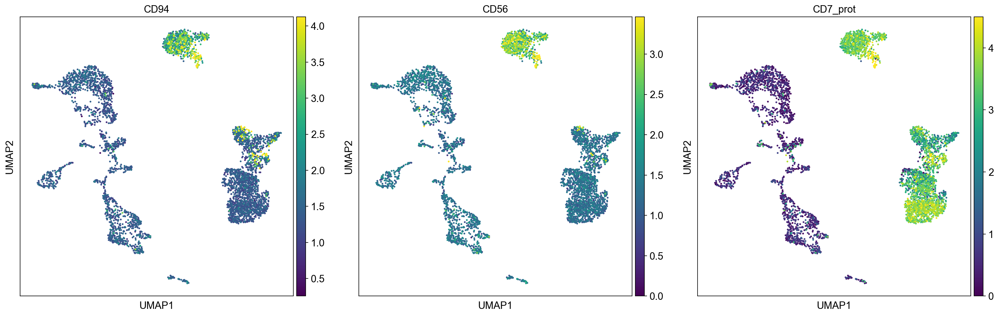

In [30]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, RNA")
sc.pl.umap(eg, color = is_nk_yang, vmax="p99", color_map = 'viridis', ncols=2)

print("Is NK cell, protein (KLRD1 = CD94, NCAM1 = CD56)")

sc.pl.umap(eg, color = is_nk_yang_prot, vmax="p99", color_map = 'viridis')

- All RNA markers to identify NK cells are showing high expression, except NCAM1 (CD56). KLRF1 and NCAM1 are quite specific for NK cells. 
- Signals from surface markers CD94 and CD56 are looking good, both maybe stronger in the immature part of the NK island. 

## 1.1 Immature CD56bright NK cells

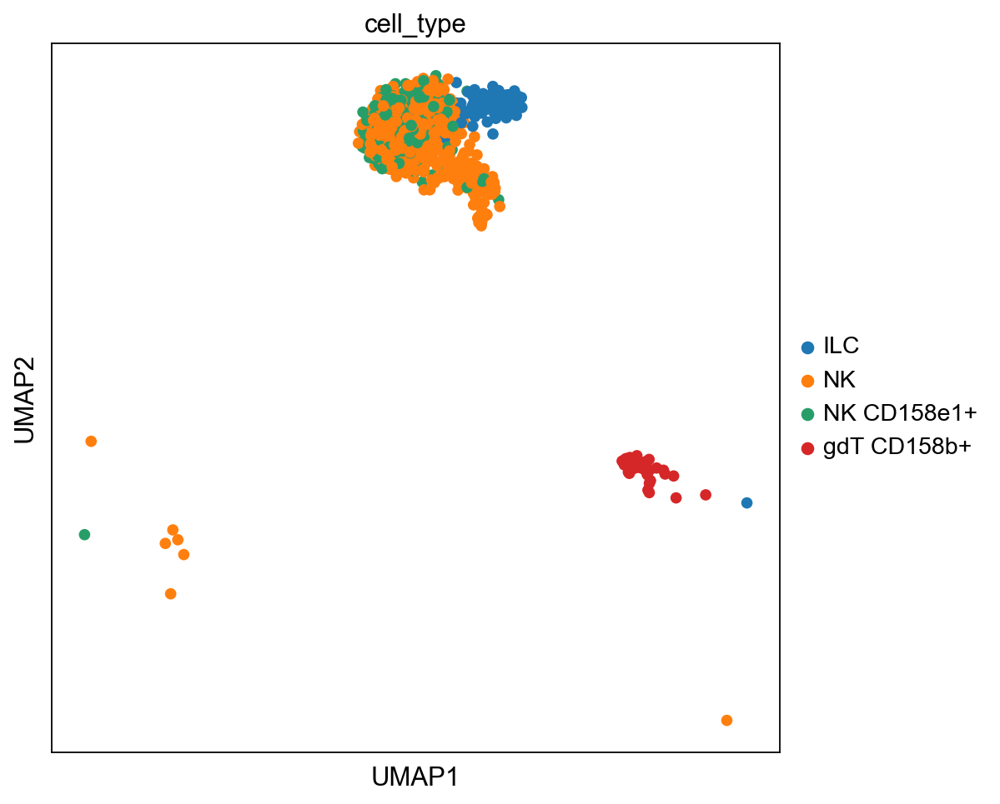

Immature CD56bright NK cells, RNA


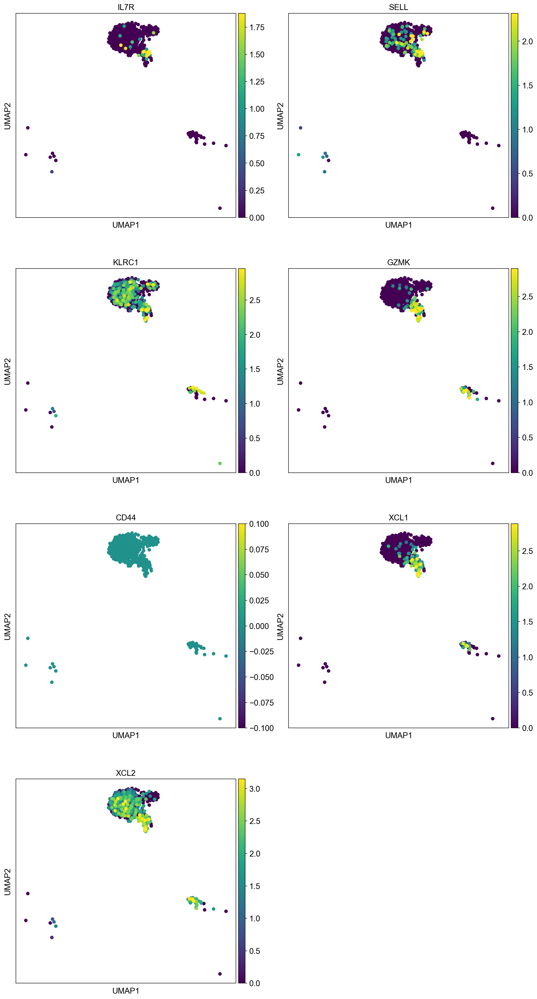

Immature CD56bright NK cells, protein


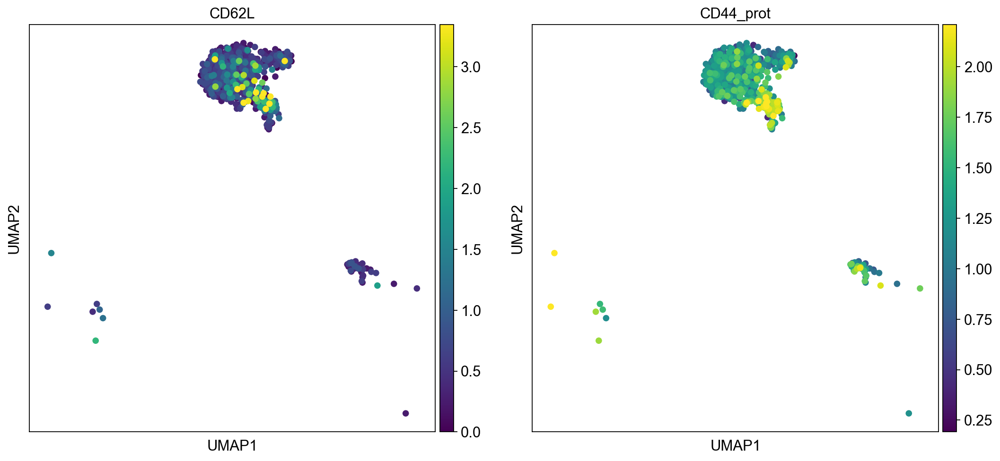

Immature CD56bright NK cells, low expression, RNA


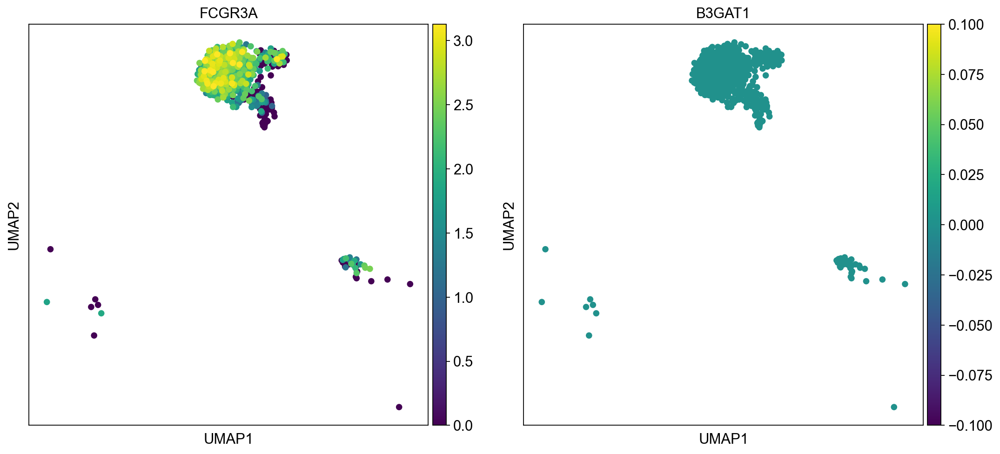

Immature CD56bright NK cells, low expression, protein


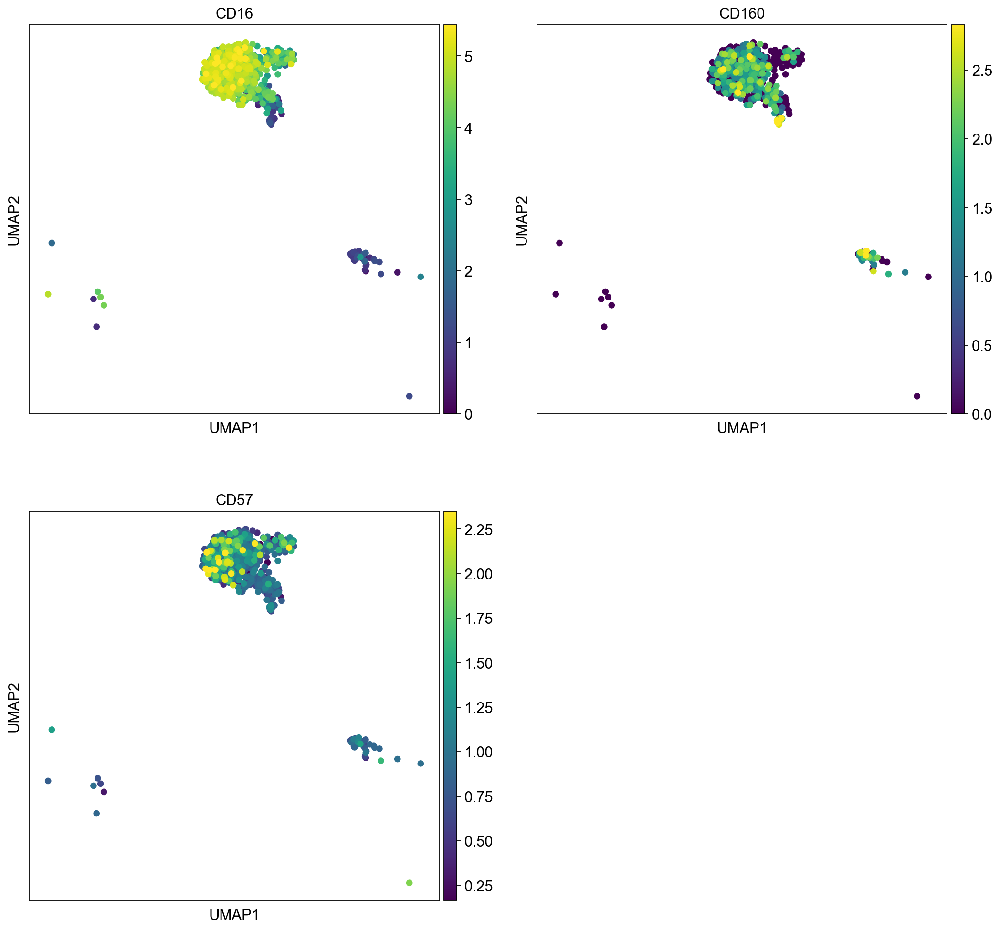

In [31]:
cd56bright_rna= ['IL7R', 'SELL', 'KLRC1', 'GZMK', 'CD44', 'XCL1', 'XCL2']
cd56bright_prot = ['CD62L', 'CD44_prot']

cd56bright_rna_low = ['FCGR3A', 'B3GAT1']
cd56bright_prot_low = ['CD16', 'CD160', 'CD57']

#CD62L = SELL, CD16 = FCGR3A, CD57 = B3GAT1

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, RNA")
sc.pl.umap(sample_nk, color = cd56bright_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, protein")
sc.pl.umap(sample_nk, color = cd56bright_prot, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, low expression, RNA")
sc.pl.umap(sample_nk, color = cd56bright_rna_low, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, low expression, protein")
sc.pl.umap(sample_nk, color = cd56bright_prot_low, vmax="p99", color_map = 'viridis', ncols=2)



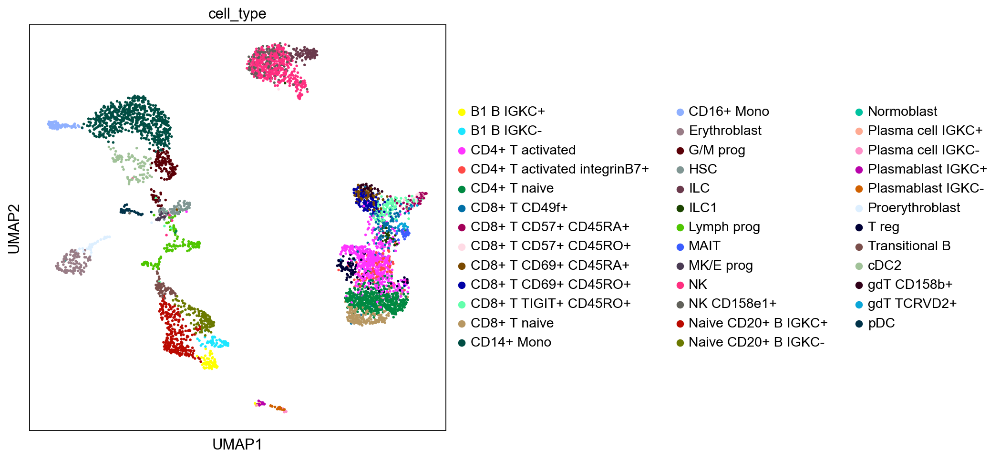

Immature CD56bright NK cells, RNA


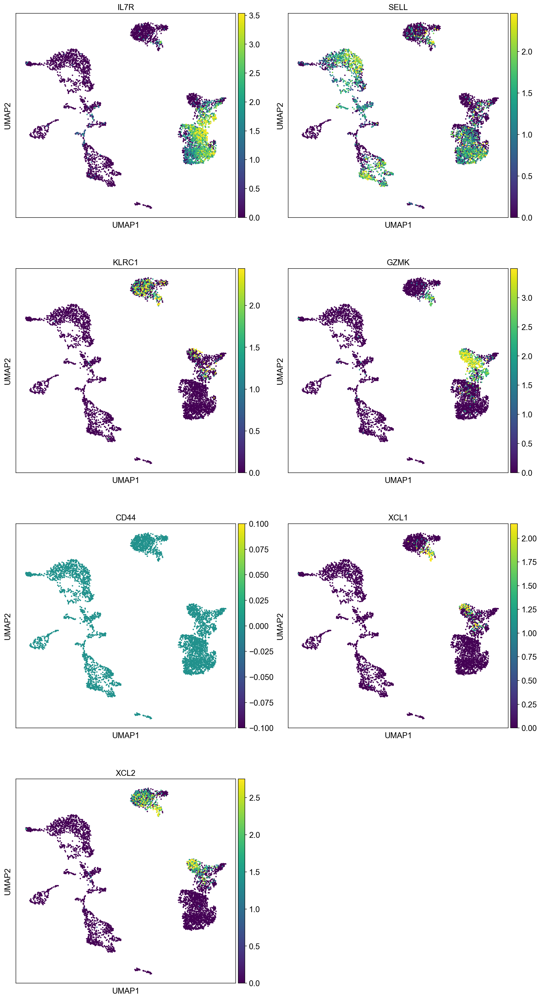

Immature CD56bright NK cells, protein


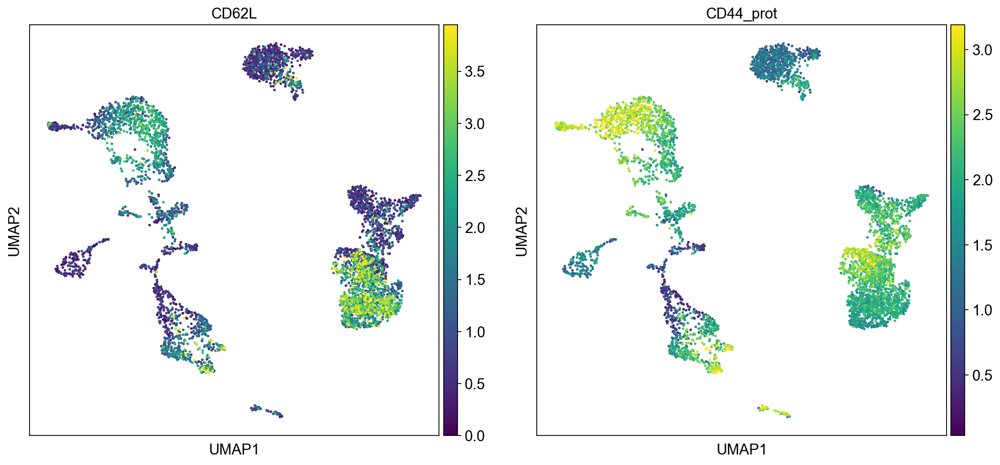

Immature CD56bright NK cells, low expression, RNA


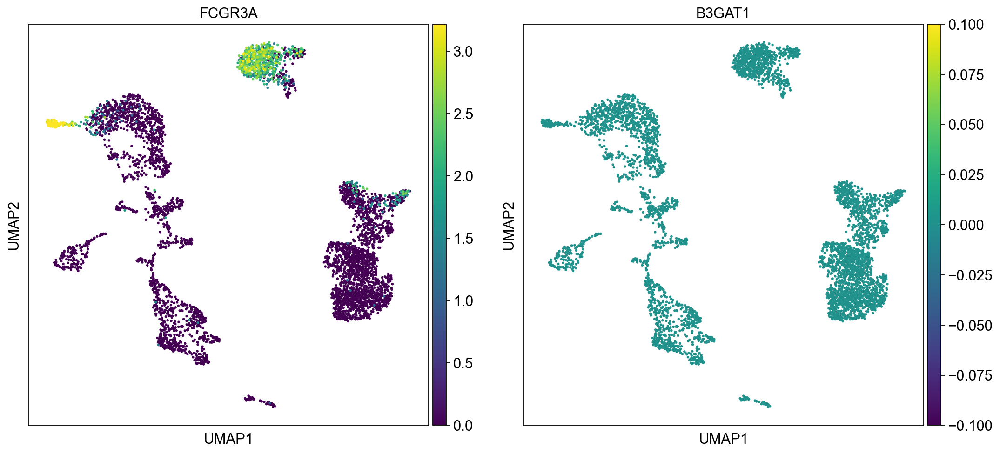

Immature CD56bright NK cells, low expression, protein


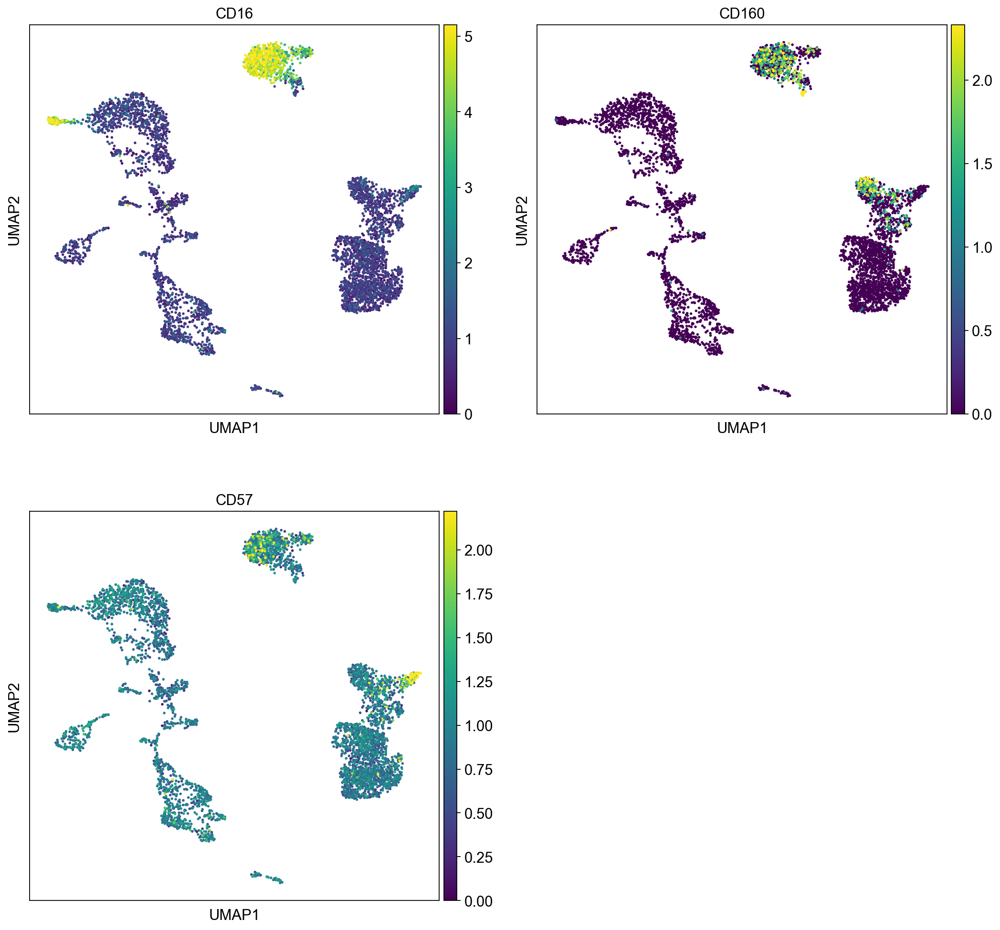

In [43]:
sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, RNA")
sc.pl.umap(eg, color = cd56bright_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, protein")
sc.pl.umap(eg, color = cd56bright_prot, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, low expression, RNA")
sc.pl.umap(eg, color = cd56bright_rna_low, vmax="p99", color_map = 'viridis', ncols=2)

print("Immature CD56bright NK cells, low expression, protein")
sc.pl.umap(eg, color = cd56bright_prot_low, vmax="p99", color_map = 'viridis', ncols=2)



- GZMK and XCL1 clearly locate in immature part of the NK island. 
- CD62L and CD44 showing higher signals in the immature part. 
- FCGR3A and corresponding CD16, as well as CD57 showing low expression in the immature part as expected. On the contrary, CD160 showing quite uniform expression. 
- None of the markers expected to have high expression in immature cells show high expression in ILCs? 

## 1.2 Transitional NK

Defined by down-regulation of the genes of CD56bright cluster and uppregulation of the genes of CD56dim cluster. 


## 1.3 Adaptive NK

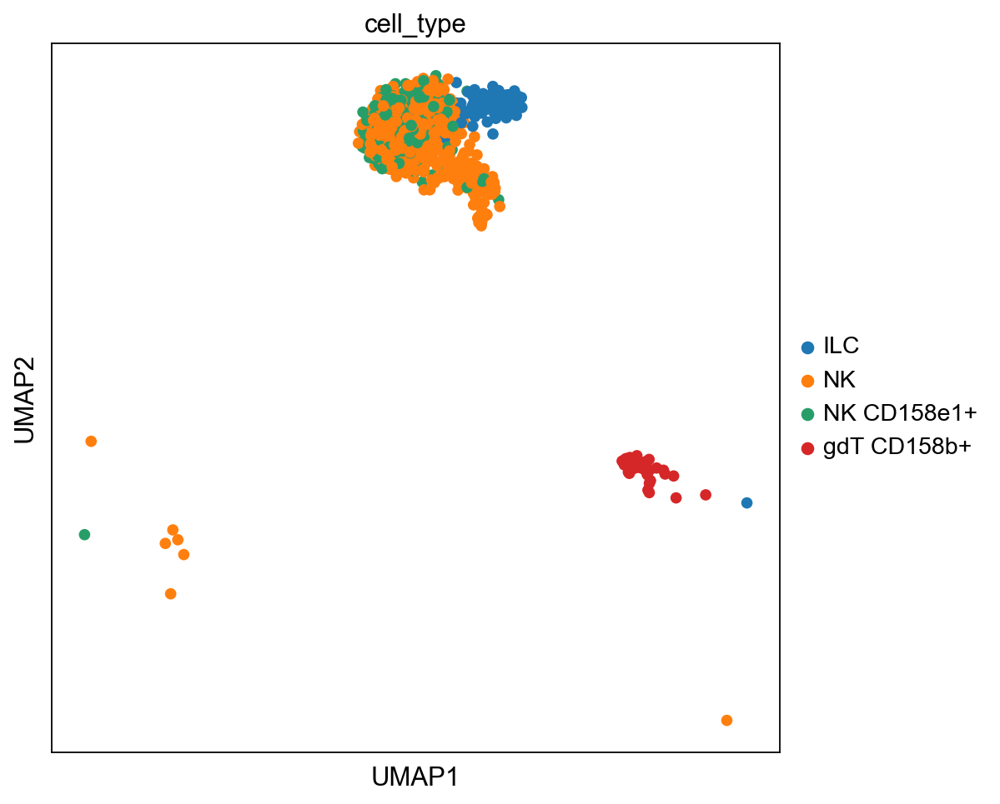

Adaptive NK cells, highly expressed, RNA


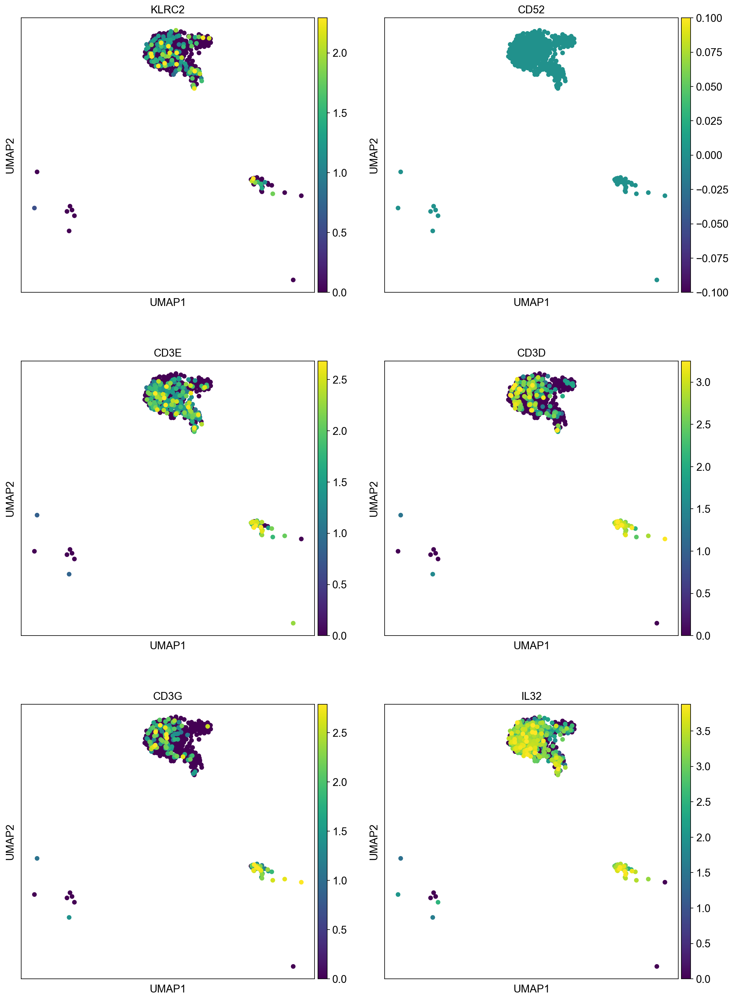

Adaptive NK cells, highly expressed, protein


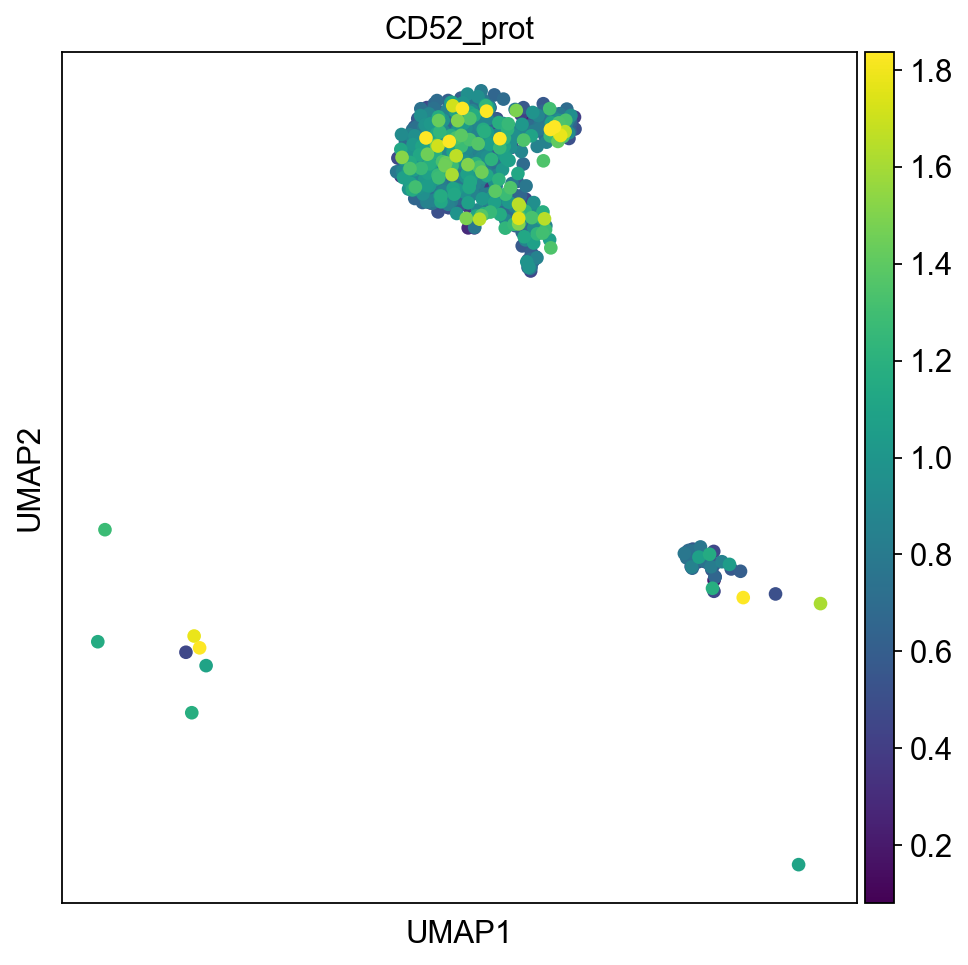

Adaptive NK cells, lower expression, RNA


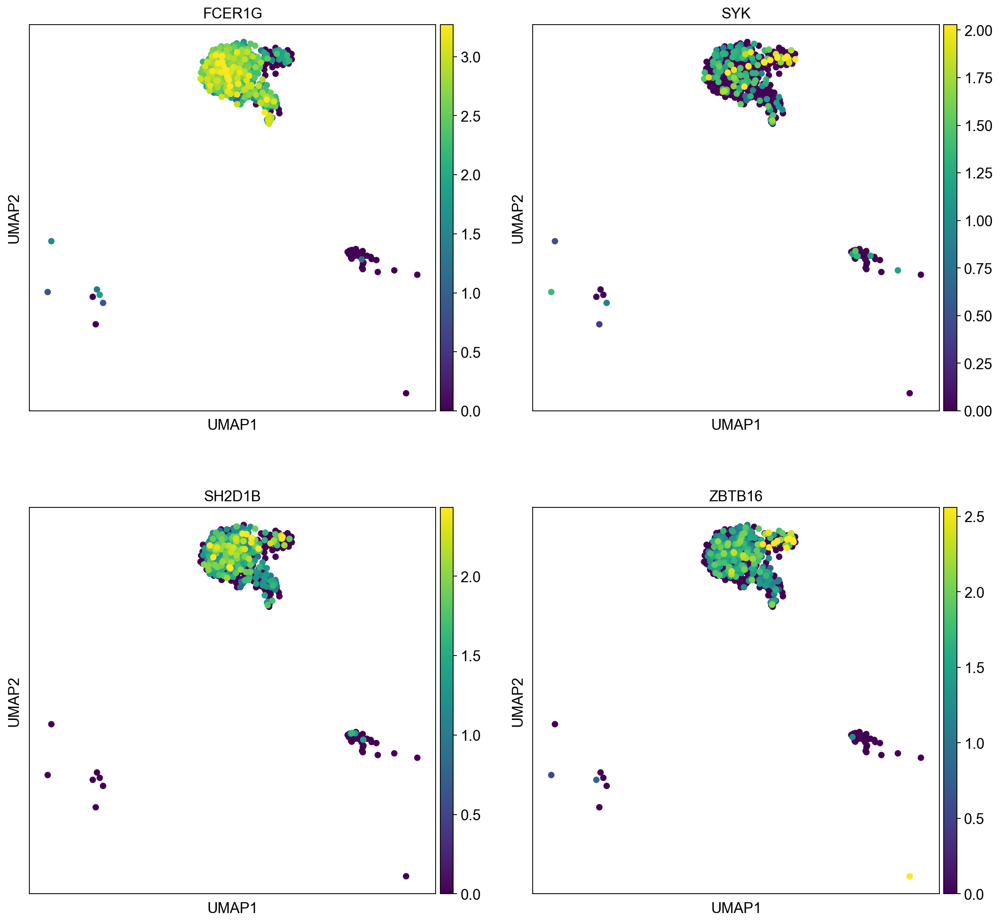

In [41]:
adaptive_high_rna = ['KLRC2', 'CD52', 'CD3E', 'CD3D', 'CD3G', 'IL32' ]
adaptive_low_rna = ['FCER1G', 'SYK', 'SH2D1B', 'ZBTB16']
adaptive_high_prot = ['CD52_prot']

#KLRC2 = CD195c, not used in the ab panel of Neurips

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, RNA")
sc.pl.umap(sample_nk, color = adaptive_high_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, protein")
sc.pl.umap(sample_nk, color = adaptive_high_prot, vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, lower expression, RNA")
sc.pl.umap(sample_nk, color = adaptive_low_rna, vmax="p99", color_map = 'viridis', ncols=2)

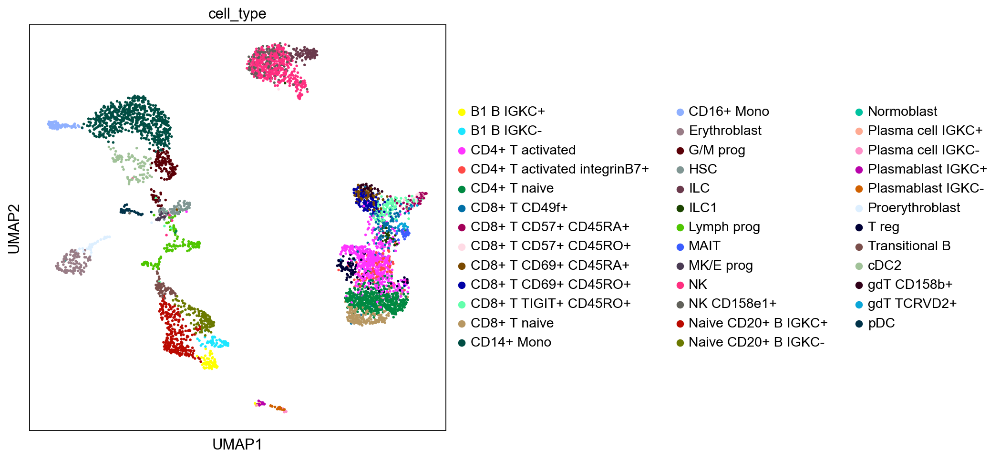

Adaptive NK cells, highly expressed, RNA


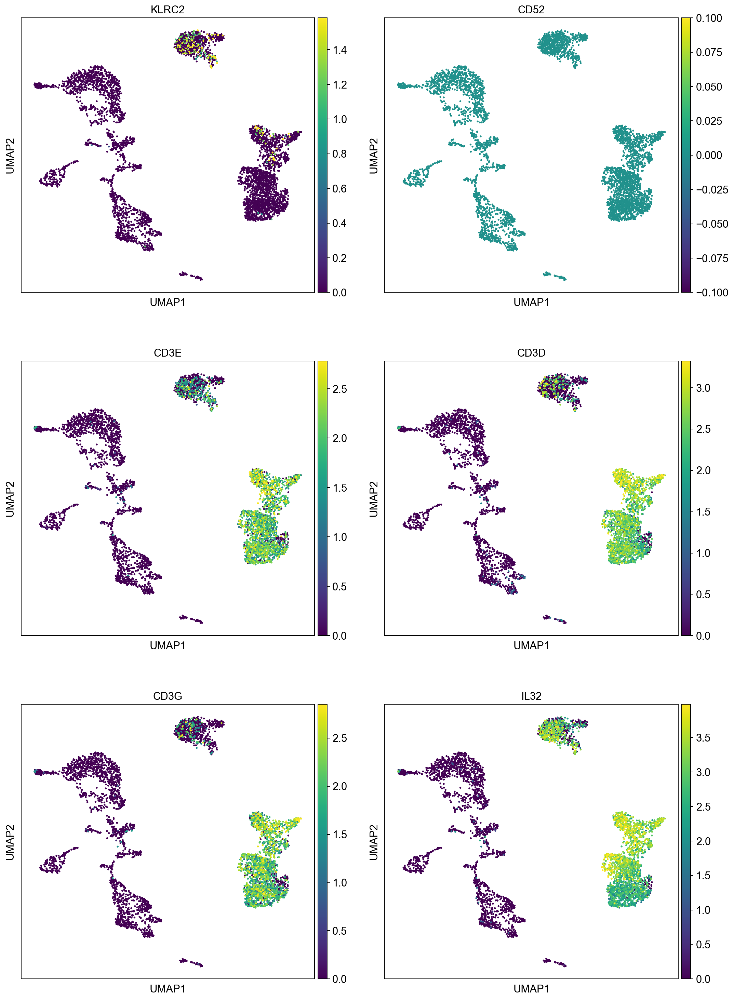

Adaptive NK cells, highly expressed, protein


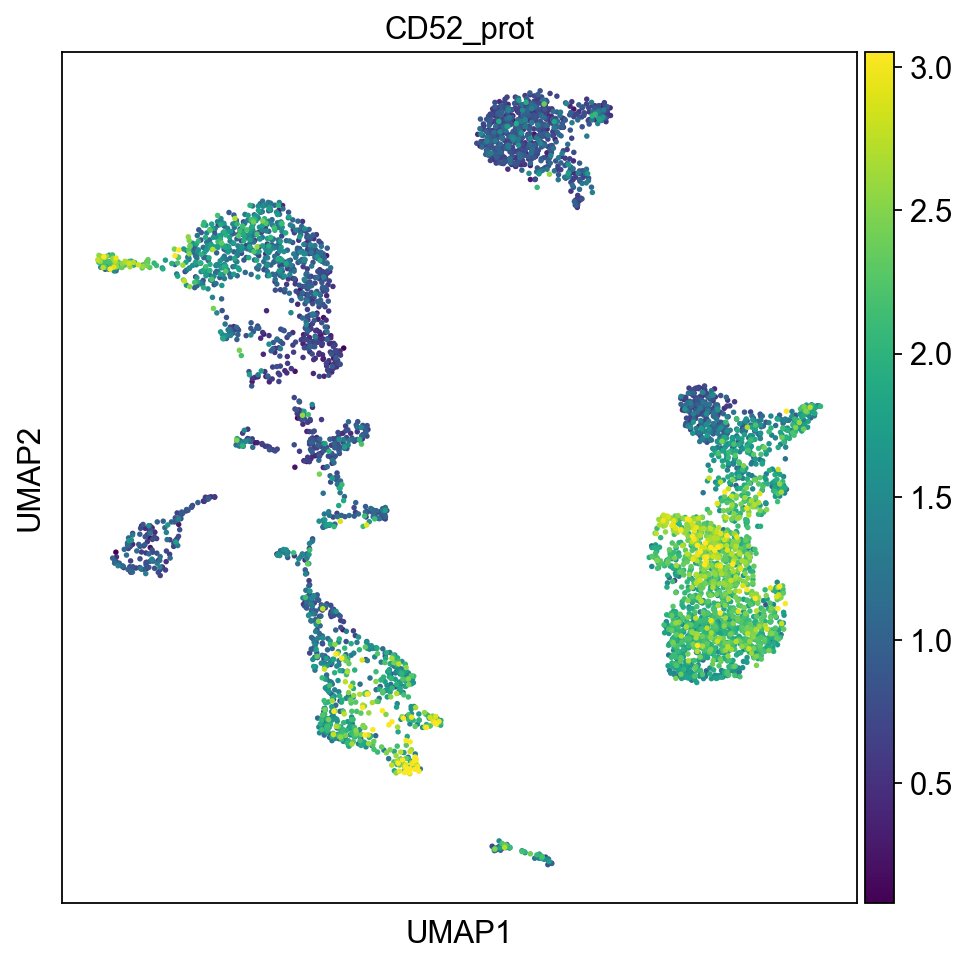

Adaptive NK cells, lower expression, RNA


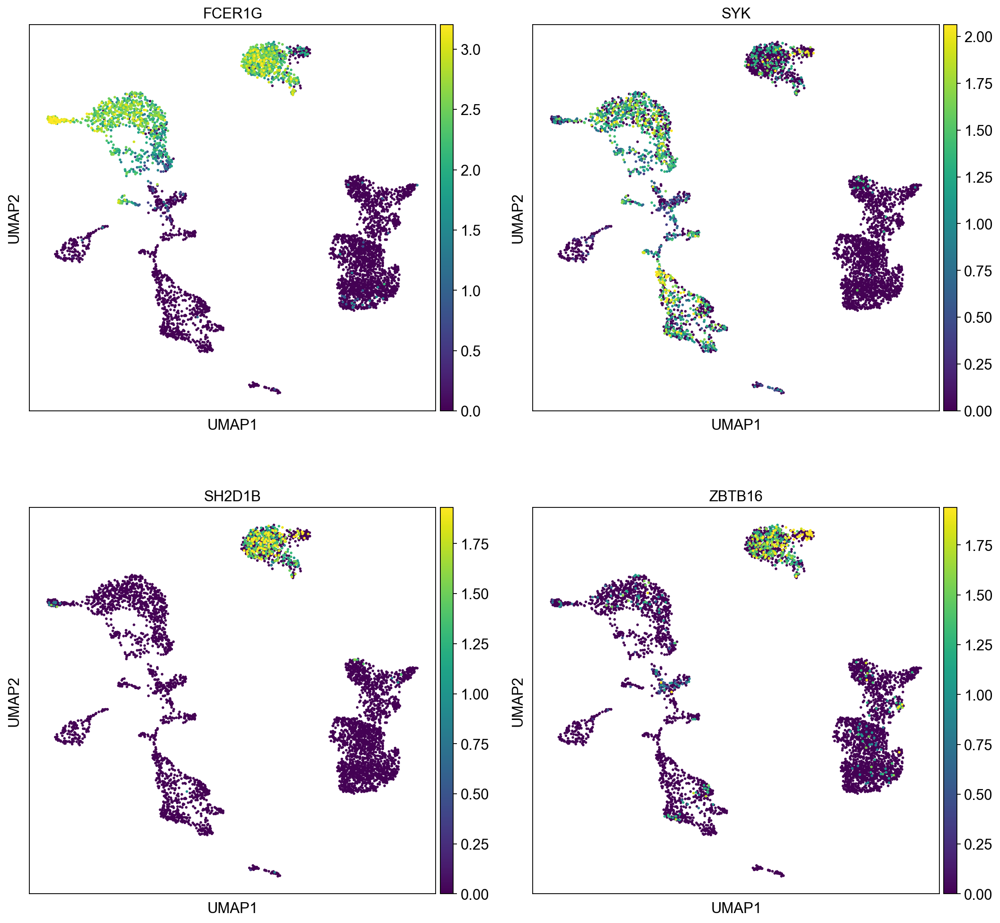

In [42]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, RNA")
sc.pl.umap(eg, color = adaptive_high_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, highly expressed, protein")
sc.pl.umap(eg, color = adaptive_high_prot, vmax="p99", color_map = 'viridis', ncols=2)

print("Adaptive NK cells, lower expression, RNA")
sc.pl.umap(eg, color = adaptive_low_rna, vmax="p99", color_map = 'viridis', ncols=2)

- Apparently, CD52 RNA was not measured in Neurips dataset. 
- Based on these UMAPs it is difficult to identify what could be the location of adaptive NK cells. At least expression of some markers, such as SH2D1B, ZBTB16, is focused on the more mature part of the NK island. 
- FCER1G not expressed in ILCs? 

## 1.4 Mature NK

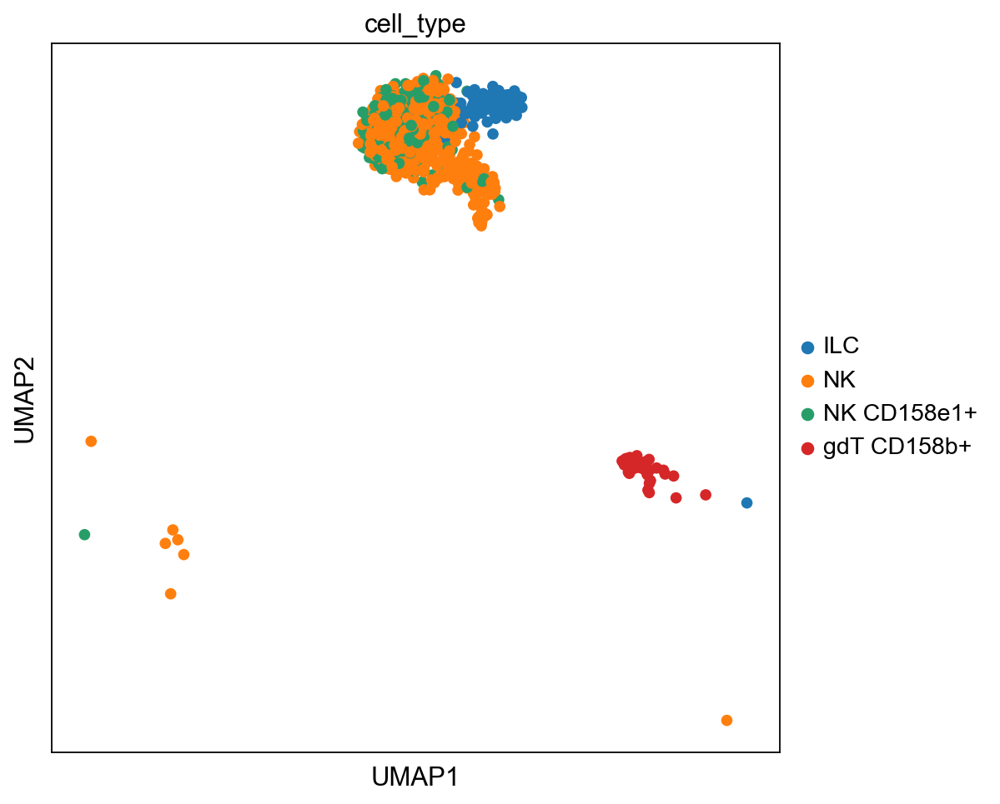

Mature NK cells, RNA


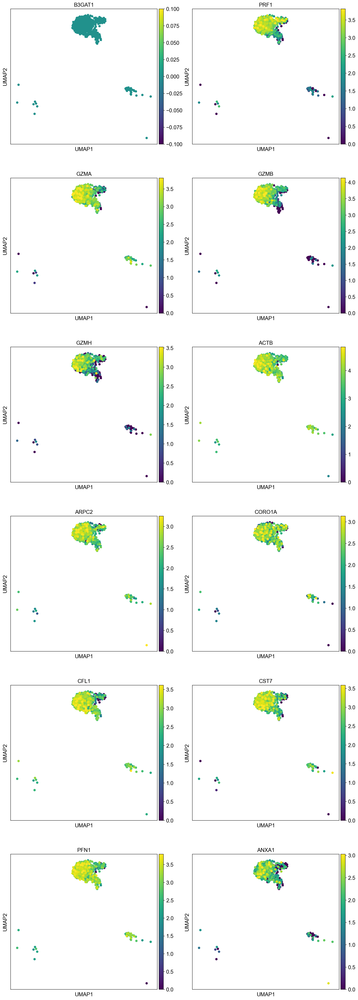

Mature NK cells, protein


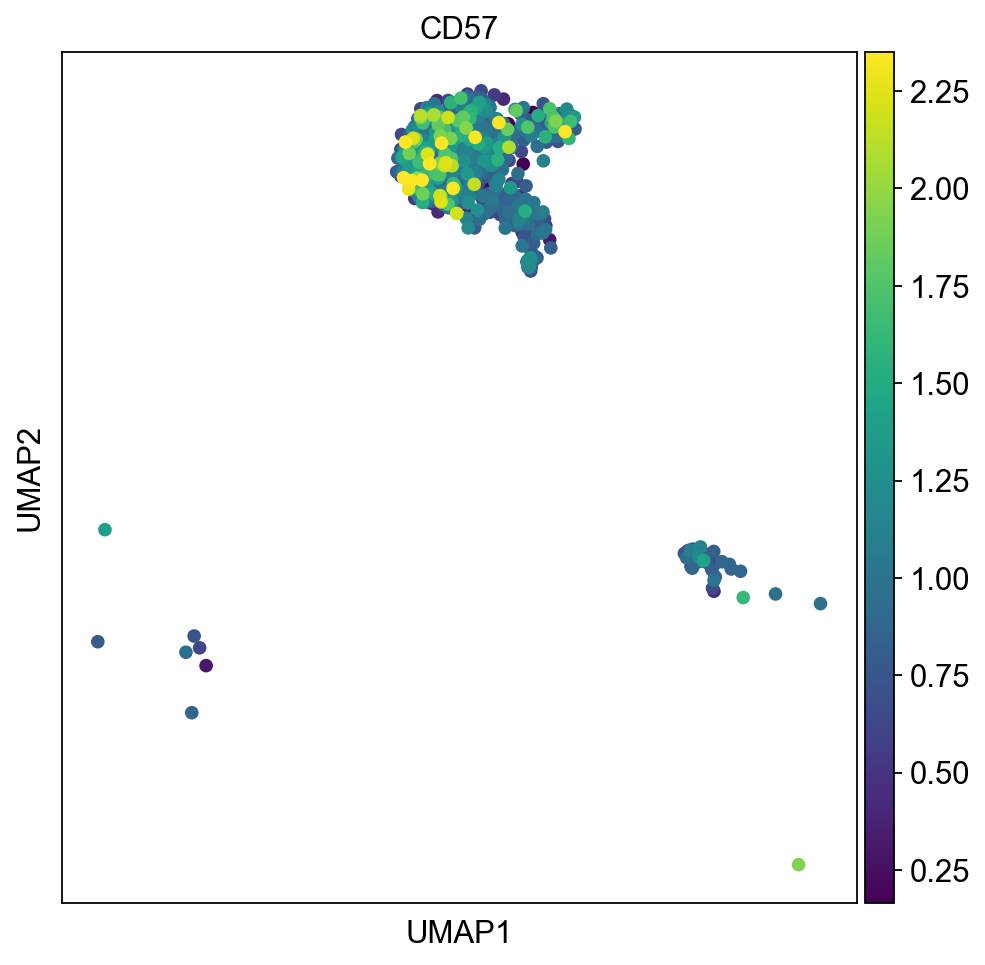

In [48]:
mature_rna= ['B3GAT1', 'PRF1', 'GZMA', 'GZMB', 'GZMH', 'ACTB', 'ARPC2', 'CORO1A', 'CFL1', 'CST7', 'PFN1', 'ANXA1']

mature_prot = ['CD57']

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, RNA")
sc.pl.umap(sample_nk, color = mature_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, protein")
sc.pl.umap(sample_nk, color = mature_prot, vmax="p99", color_map = 'viridis', ncols=2)



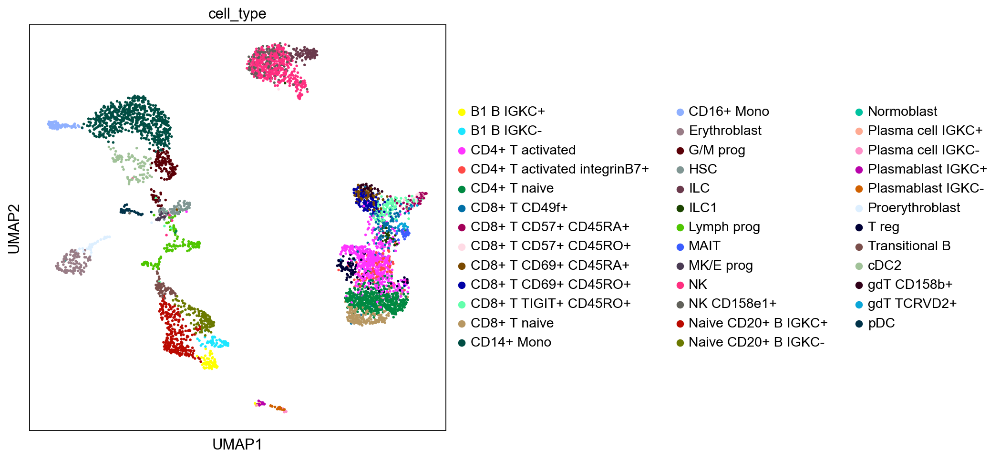

Mature NK cells, RNA


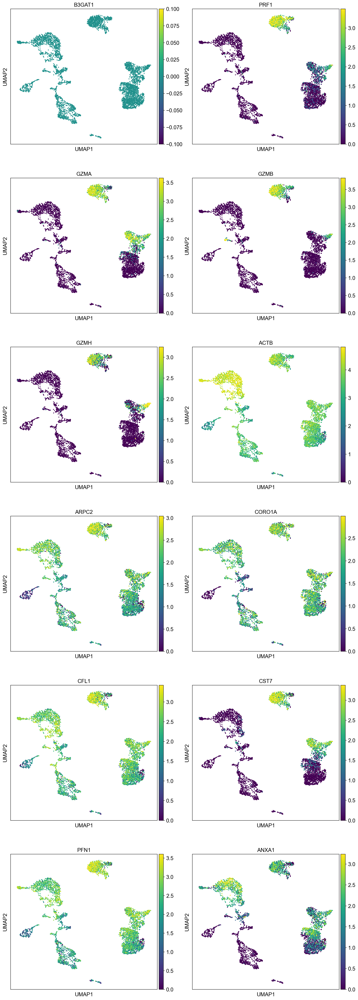

Mature NK cells, protein


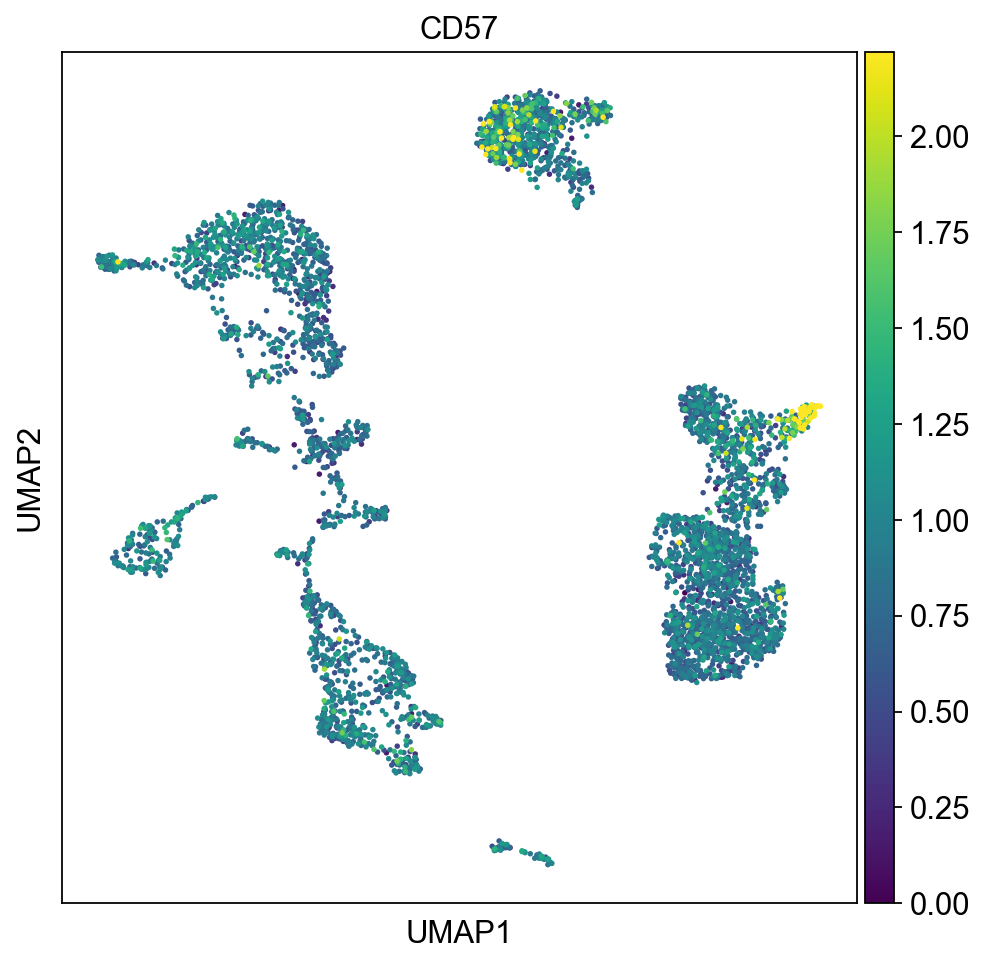

In [49]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, RNA")
sc.pl.umap(eg, color = mature_rna, vmax="p99", color_map = 'viridis', ncols=2)

print("Mature NK cells, protein")
sc.pl.umap(eg, color = mature_prot, vmax="p99", color_map = 'viridis', ncols=2)




- According to the paper, increasing ANXA1 expression was detected as NK cells maturate. Similar pattern could be seen also in this dataset.
- All markers shown here appear to have higher expression in the mature NK cells, but some are not specific for NK cells and show even higher expression in other cell populations. 
- Granzymes appear to be quite specific for NK cells and especially granzyme B and H are highly expressed in the mature NK cells. 
- Similarly PRF1 shows high expression in mature NK cells. 
- Perforin (PRF1) and different granzymes (GZMA, GZMB, GZMH) are quite NK cell sepcific. 
- Some of the markers, such as ANXA1, CFL1, GZMA and CST7, are not higly expressed in ILCs. Potential to use when separating NK cells from other ILCs? 

## 1.5 Terminal NK cells 

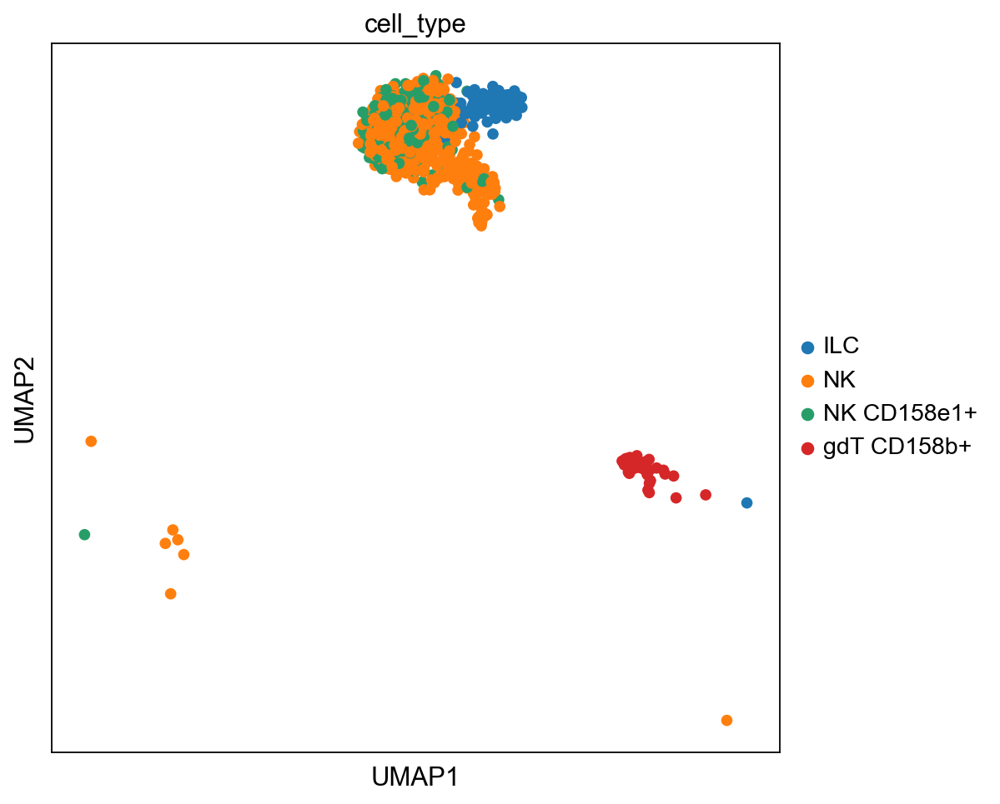

Terminal NK cells, RNA


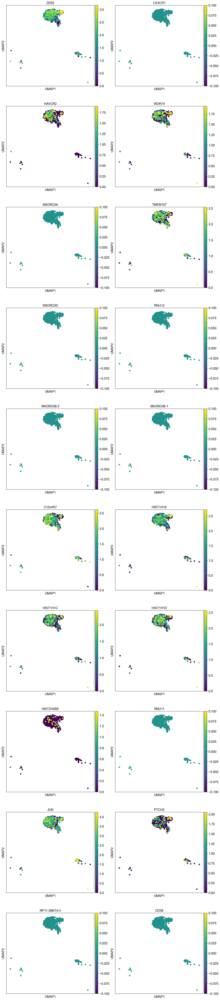

Terminal NK cells, protein


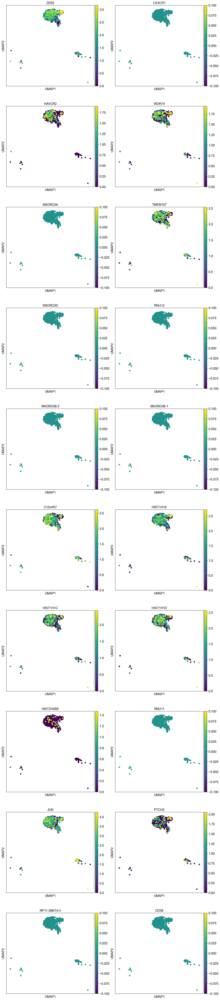

Terminal NK cells (blood), RNA


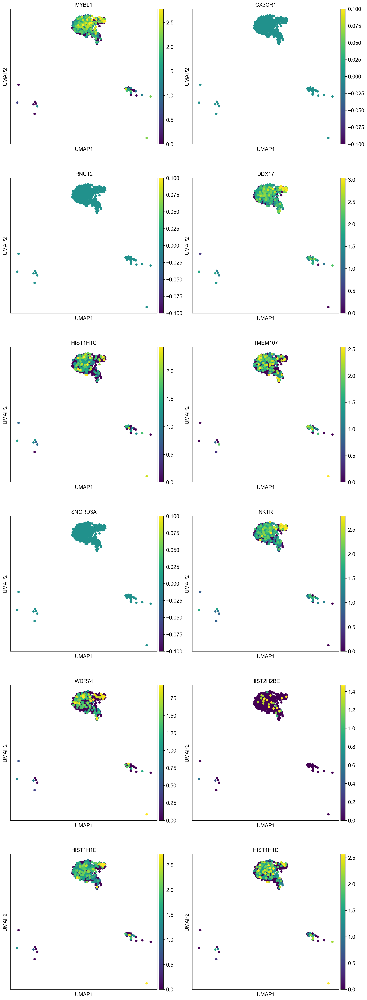

In [54]:
terminal_rna_bm = ['ZEB2',  'CX3CR1','HAVCR2','WDR74', 'SNORD3A', 'TMEM107', 'SNORD3D', 'RNU12', 'SNORD3B-2', 'SNORD3B-1', 'C12orf57', 'HIST1H1E', 'HIST1H1C', 'HIST1H1D', 'HIST2H2BE', 'RNU11', 'JUN', 'PTCH2', 'RP11-386I14.4','CD38']
terminal_prot_bm = ['CD38_prot']
terminal_rna_pb =  ['MYBL1', 'CX3CR1', 'RNU12', 'DDX17', 'HIST1H1C', 'TMEM107', 'SNORD3A', 'NKTR', 'WDR74', 'HIST2H2BE', 'HIST1H1E', 'HIST1H1D']

# 'NEAT' not found in dataser

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Terminal NK cells, RNA")
sc.pl.umap(sample_nk, color = terminal_rna_bm, vmax="p99", color_map = 'viridis', ncols=2)


print("Terminal NK cells, protein")
sc.pl.umap(sample_nk, color = terminal_rna_bm, vmax="p99", color_map = 'viridis', ncols=2)


print("Terminal NK cells (blood), RNA")
sc.pl.umap(sample_nk, color = terminal_rna_pb, vmax="p99", color_map = 'viridis', ncols=2)




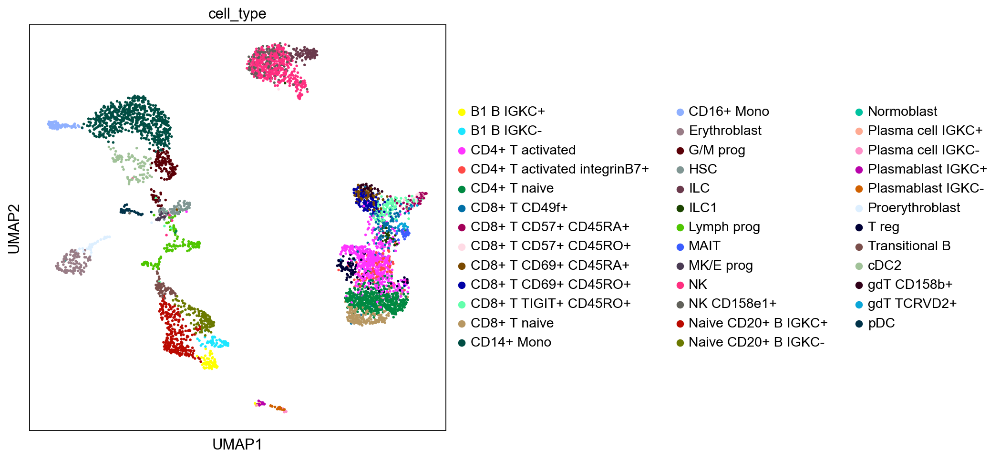

Terminal NK cells, RNA


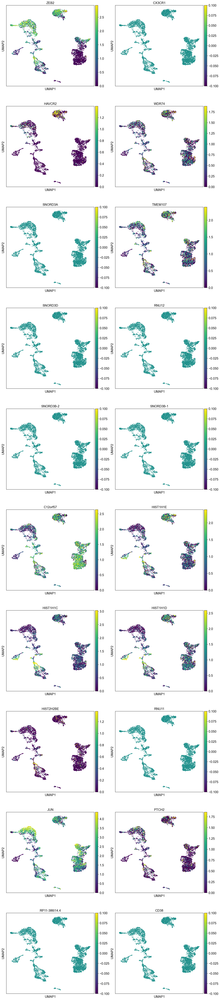

Terminal NK cells, protein


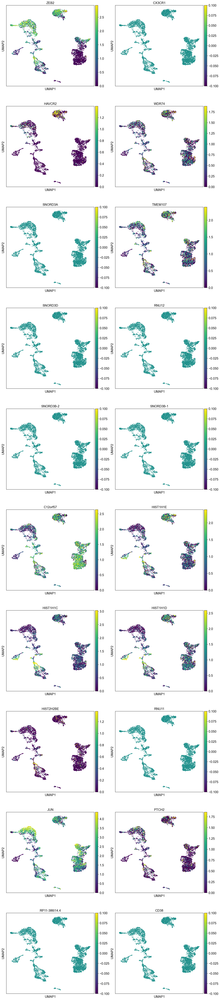

Terminal NK cells (blood), RNA


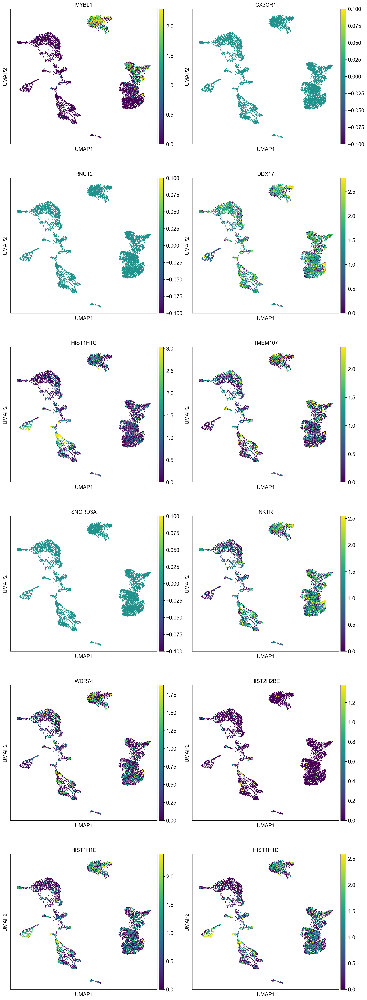

In [55]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Terminal NK cells, RNA")
sc.pl.umap(eg, color = terminal_rna_bm, vmax="p99", color_map = 'viridis', ncols=2)


print("Terminal NK cells, protein")
sc.pl.umap(eg, color = terminal_rna_bm, vmax="p99", color_map = 'viridis', ncols=2)


print("Terminal NK cells (blood), RNA")
sc.pl.umap(eg, color = terminal_rna_pb, vmax="p99", color_map = 'viridis', ncols=2)



## 1.6 Inflamed NK cells

According to the paper, this  cluster was mostly composed of cells of one patient, who donored BM. 

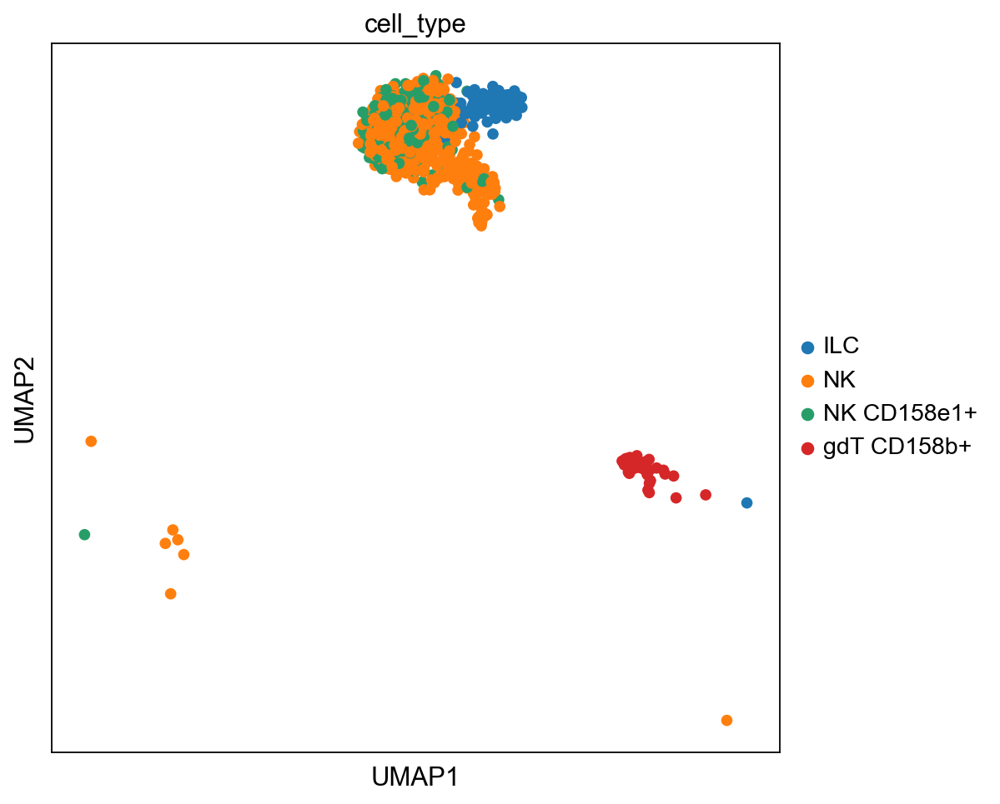

Inflamed NK cells, RNA


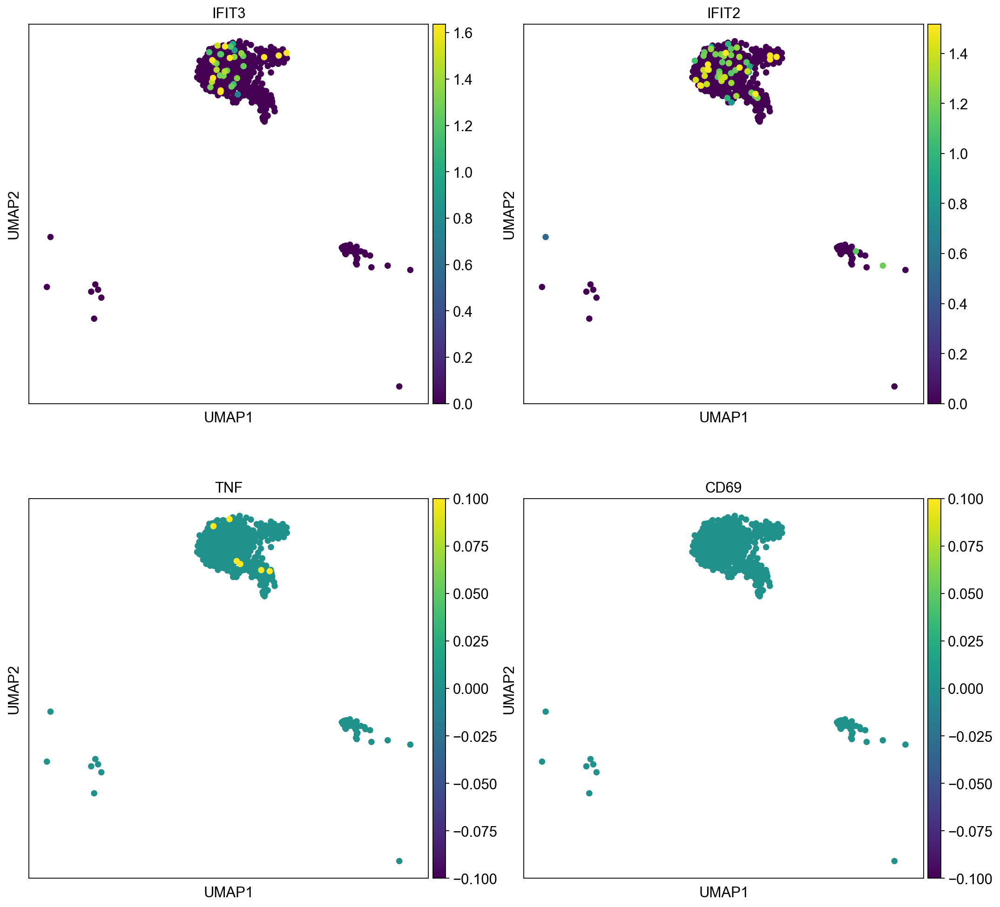

Inflamed NK cells, protein


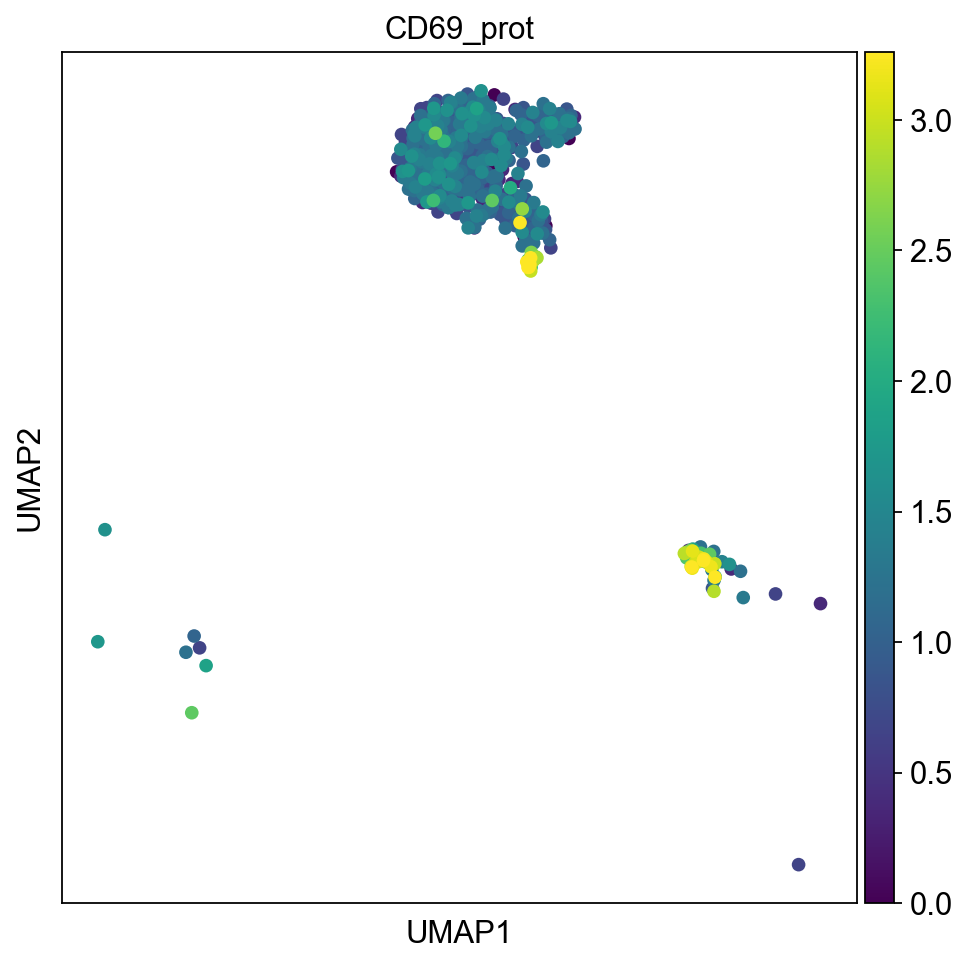

In [58]:
sc.set_figure_params(figsize=(7, 7))

inflamed_nk = ['IFIT3', 'IFIT2', 'TNF', 'CD69']
inflamed_nk_prot = ['CD69_prot']

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, RNA")
sc.pl.umap(sample_nk, color = inflamed_nk, vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, protein")
sc.pl.umap(sample_nk, color = inflamed_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




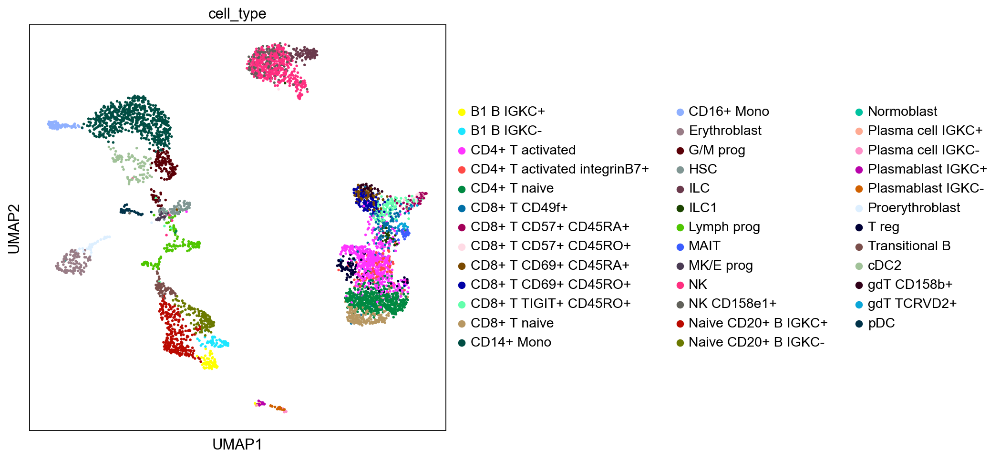

Inflamed NK cells, RNA


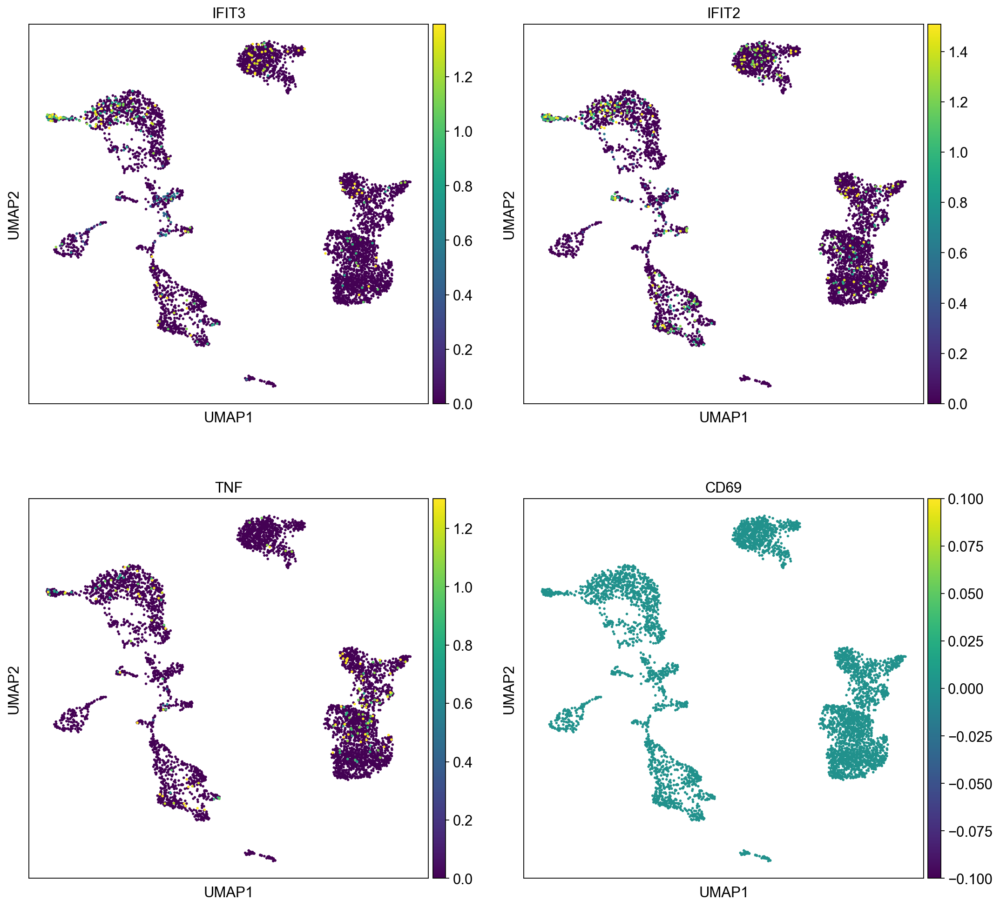

Inflamed NK cells, protein


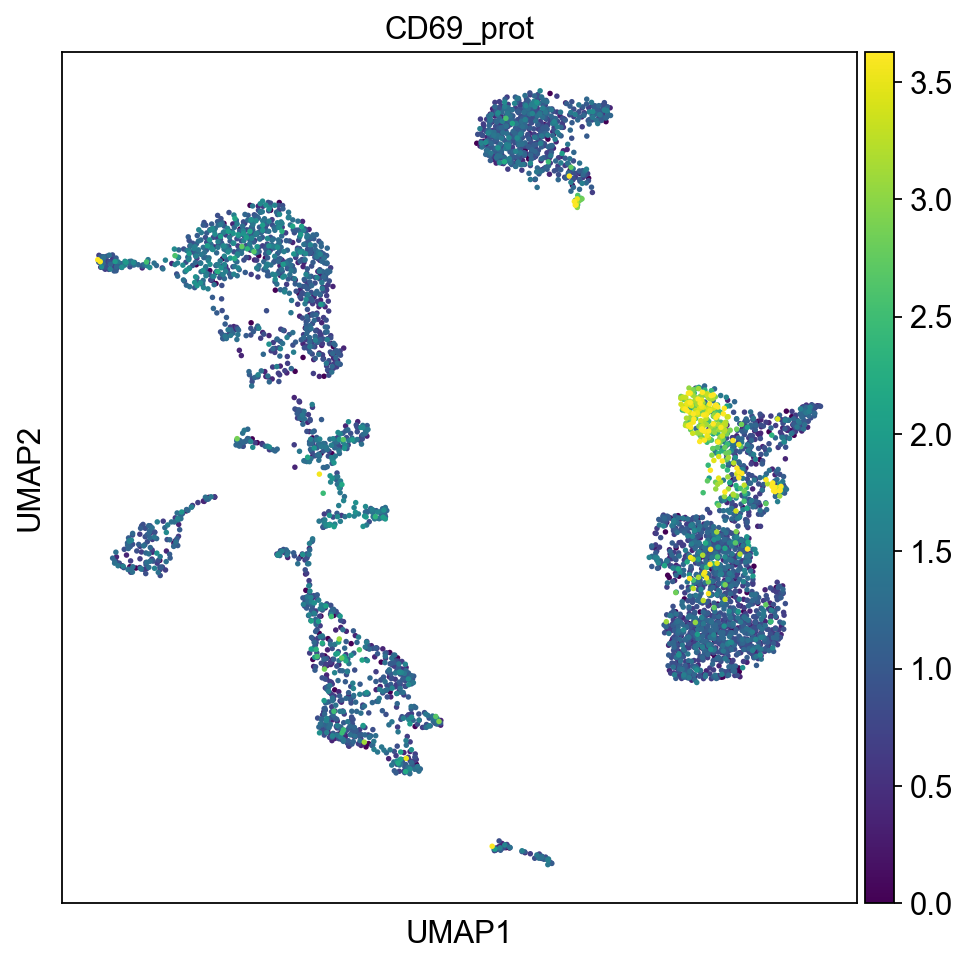

In [59]:
sc.set_figure_params(figsize=(7, 7))

inflamed_nk = ['IFIT3', 'IFIT2', 'TNF', 'CD69']
inflamed_nk_prot = ['CD69_prot']

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, RNA")
sc.pl.umap(eg, color = inflamed_nk, vmax="p99", color_map = 'viridis', ncols=2)

print("Inflamed NK cells, protein")
sc.pl.umap(eg, color = inflamed_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




- In the paper this subpopulation of NK cells was only found in one patient, so maybe not relevant finding? This population shares similar features with identified active NK cell cluster. 

## 1.3. Active NK cells

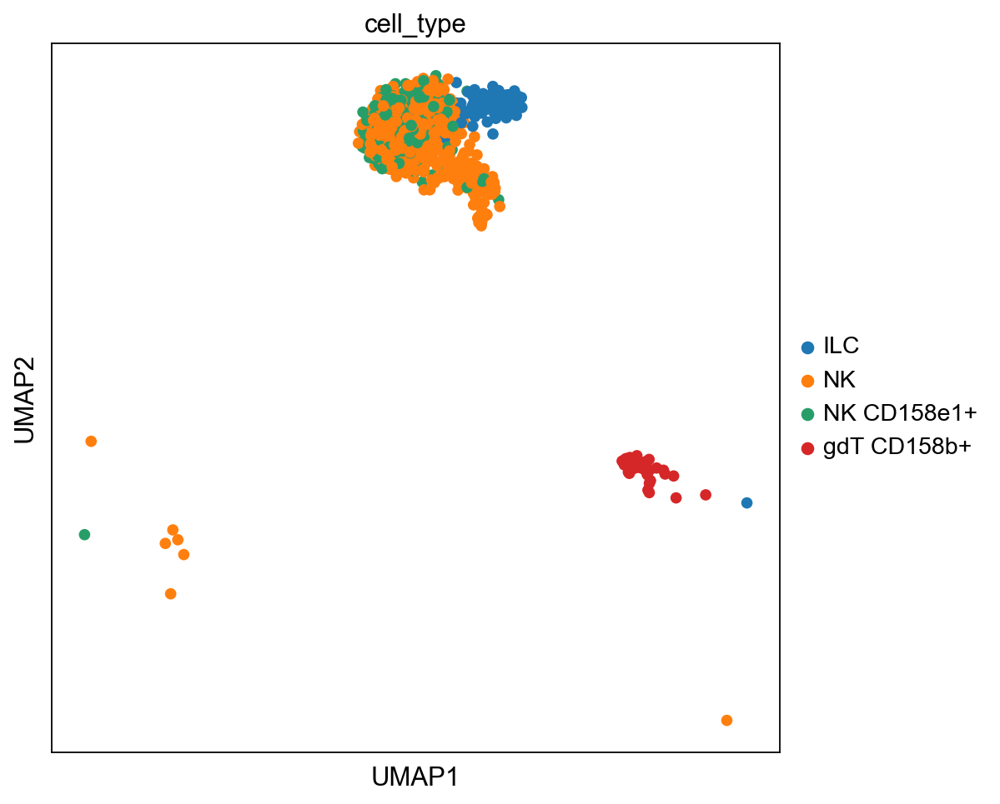

Active NK cells, RNA


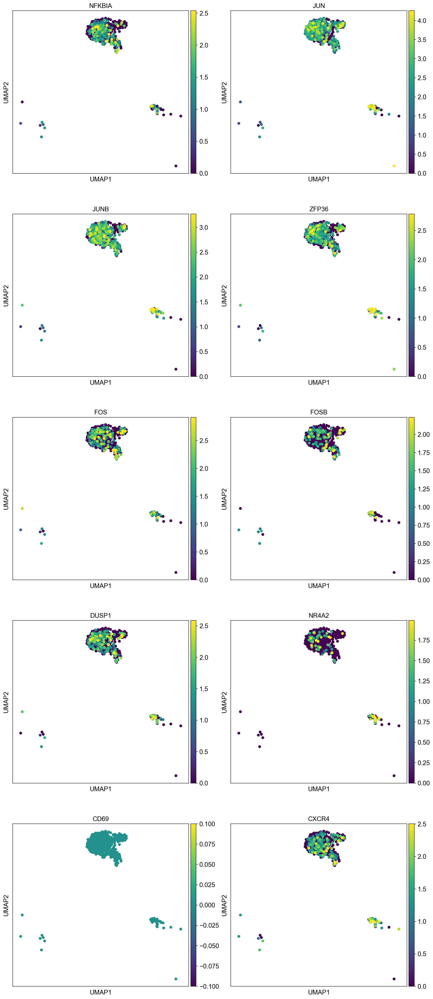

Active NK cells, protein


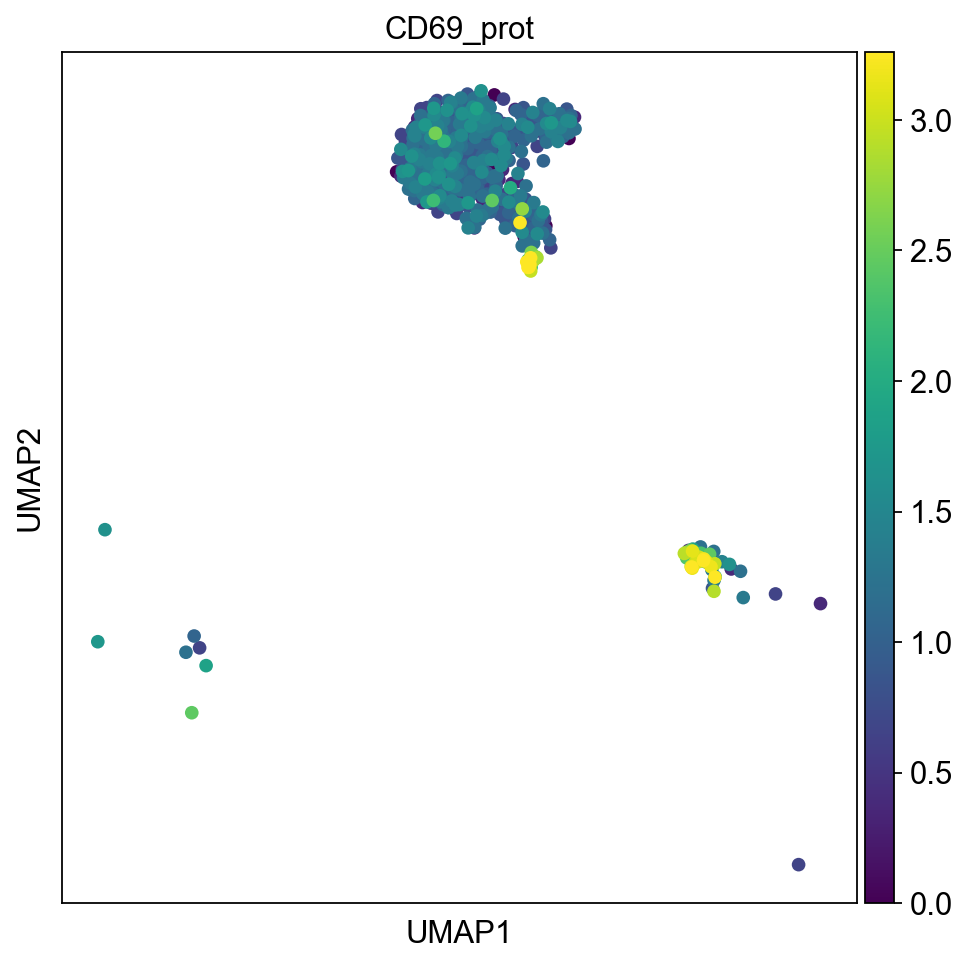

In [62]:
#In this population CXCR4 expression is high, but expression is reduced when NK cells become functionally mature
# CXCR4 = CD184, ab not used in Neurips dataset

active_nk= ['NFKBIA', 'JUN', 'JUNB', 'ZFP36', 'FOS', 'FOSB', 'DUSP1', 'NR4A2', 'CD69','CXCR4']
active_nk_prot = ["CD69_prot"]

sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Active NK cells, RNA")
sc.pl.umap(sample_nk, color = active_nk, vmax="p99", color_map = 'viridis', ncols=2)

print("Active NK cells, protein")
sc.pl.umap(sample_nk, color = active_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




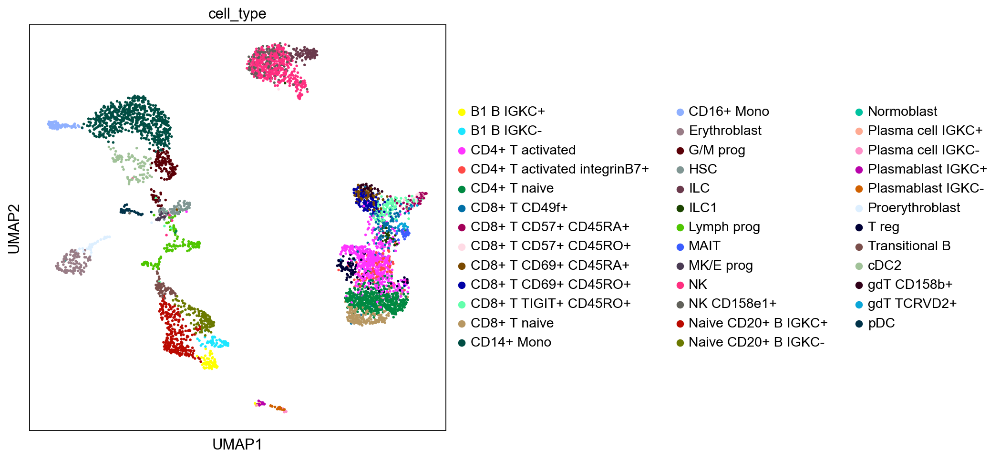

Active NK cells, RNA


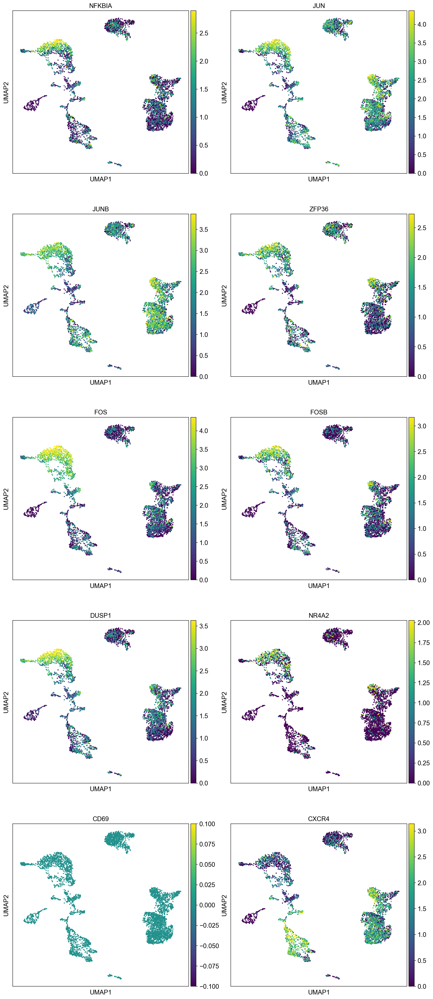

Active NK cells, protein


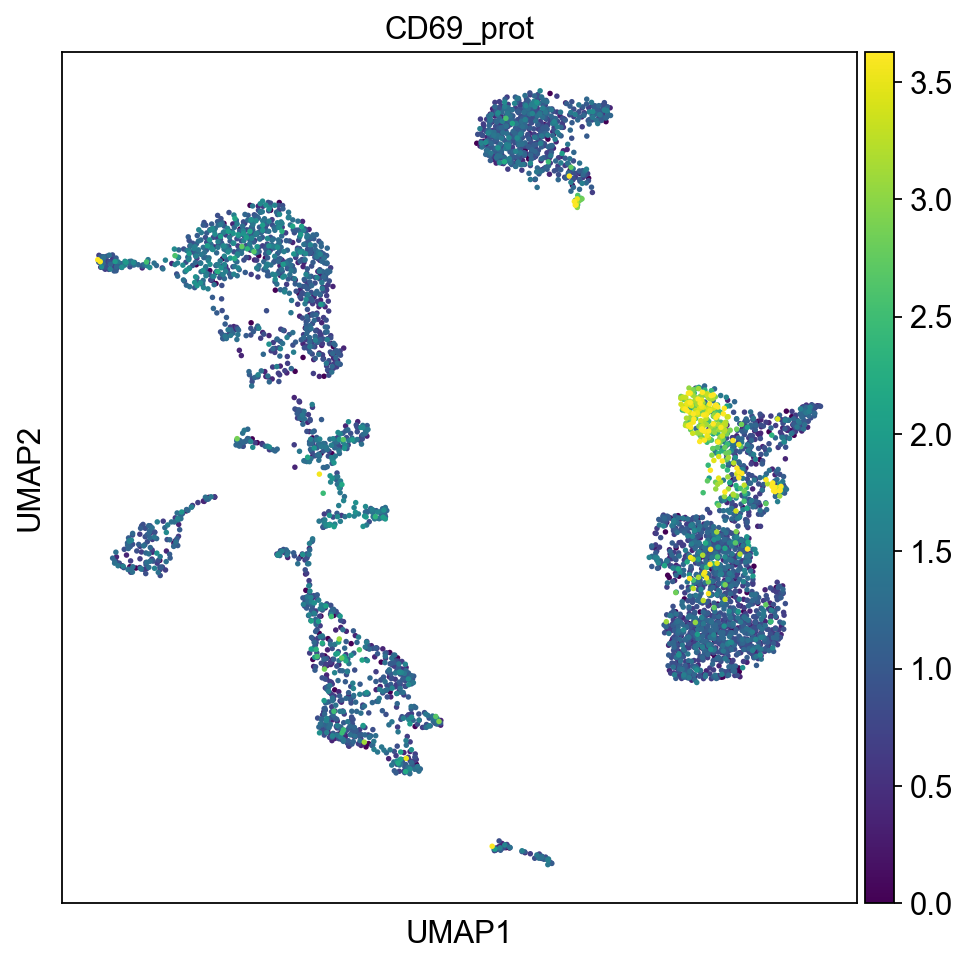

In [156]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print("Active NK cells, RNA")
sc.pl.umap(eg, color = active_nk, vmax="p99", color_map = 'viridis', ncols=2)


print("Active NK cells, protein")
sc.pl.umap(eg, color = active_nk_prot, vmax="p99", color_map = 'viridis', ncols=2)




- In the paper, it was suggested that this subpopulation might locate within mature NK cells (CD56dim) and may not be unique developmental stage. 
- In these UMAPs these markers seem to be expressed quite uniformly across the NK cells island. Expression also seems to be higher in other cell populations, expecially in T cells. 